In [350]:
from pathlib import Path
import numpy as np
import cv2
import matplotlib.pyplot as plt 
import matplotlib.colors as mcolors
import pandas as pd
import pupil_labs.video as plv
from utils import VideoHandler, write_action_timestamp_csv
from optic_flow import OpticFlowCalculatorFarneback,OpticFlowCalculatorLK
from sync_videos import OffsetCalculator
import matplotlib.patches as patches
from gaze_mapper import ActionCameraGazeMapper, ActionCameraGazeMapper2
import cv2 as cv

Insert here the paths to the action camera video, to the neon scene video and to the worldtimestamps.csv of the Neon Timeseries

In [185]:
output_dir='/users/sof/action_map_experiments/'

output_dir=Path(output_dir,f'second_video_2')
output_dir.mkdir(exist_ok=True,parents=True)

In [186]:
neon_timeseries_path='/users/sof/video_examples/second_video/2024-05-23_16-47-35-a666ea62'
neon_vid_path='/users/sof/video_examples/second_video/2024-05-23_16-47-35-a666ea62/e69049ea_0.0-42.986.mp4'
action_vid_path='/users/sof/video_examples/second_video/20240523_171941_000.mp4'

In [10]:
action_vid_path='/users/sof/gaze_mapping/raw_videos/InstaVid/wearingNeon_2m/AVun_20240216_160246_055.mp4'
neon_vid_path='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-16_wearingNeon/2024-02-16_15-58-13-6310bec3/cc00c32d_0.0-146.071.mp4'
neon_timestamps='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-16_wearingNeon/2024-02-16_15-58-13-6310bec3/world_timestamps.csv'

In [11]:
action_vid_path='/users/sof/gaze_mapping/raw_videos/InstaVid/mydesk_30s/AVun_20240209_151819_500.mp4'
neon_vid_path='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-09_mydesk/2024-02-09_14-42-01-709be38d/a6a8a333_0.0-30.107.mp4'
neon_timestamps='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-09_mydesk/2024-02-09_14-42-01-709be38d/world_timestamps.csv'

Just one search to a frame in index 1000 doesnt consume a lot of RAM, what devours RAM is multiple calls

----------
Before kernel starts: 3.78G

After running the cells above this one: 3.88G

Getting frames 1000,1001 and 1002: 4.15G (Consumed .27G)

----------
Before kernel starts: 3.77G

After running the cells above this one: 3.87G

Getting frames 0,1 and 2: 4.15G (Consumed .28G)

-----------
Before kernel starts: 3.8G

After running the cells above this one: 3.89G

Getting frames 0-149: 18.3G (Consumed 14.41G)


In [12]:
action_vid_path='/users/sof/video_examples/second_video/20240523_171941_000.mp4'


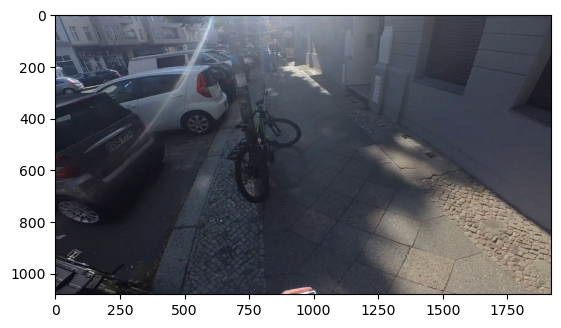

In [13]:
a=VideoHandler(action_vid_path)
a.get_closest_timestamp(5)
f=a.get_frame_by_timestamp(5)
plt.imshow(f)

In [14]:
rr=pd.read_csv(neon_timestamps)
rr.head()

,section id,recording id,timestamp [ns]
0,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121631000000
1,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121681000000
2,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121731000000
3,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121781000000
4,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121831000000


In [15]:
rr['timestamp [ns]'].values[-1]

1707486151724566666

In [16]:
rr.head()

,section id,recording id,timestamp [ns]
0,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121631000000
1,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121681000000
2,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121731000000
3,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121781000000
4,a6a8a333-42d2-4dc1-8188-a276ed8a7409,709be38d-4158-48b9-a1fa-cd217a1a2bff,1707486121831000000


In [17]:
a=VideoHandler(action_vid_path)

Error in callback <function _draw_all_if_interactive at 0x7f6987b028e0> (for post_execute), with arguments args (),kwargs {}:


KeyboardInterrupt: 

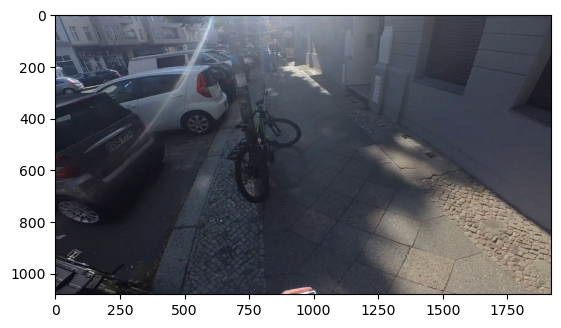

In [18]:
a.get_closest_timestamp(5)
f=a.get_frame_by_timestamp(5)
plt.imshow(f)

In [ ]:
a.video_stream.close()

In [ ]:
f=a.get_frame_by_timestamp(5)

In [ ]:
ts=a.timestamps
after=np.searchsorted(ts,5.005,'right')
before=after-1

In [ ]:
np.searchsorted(ts,5.005,'right'),np.searchsorted(ts,5.005,'left')

(150, 150)

In [ ]:
np.array([ts[before],ts[after]])-5.005

array([-0.03336668,  0.        ], dtype=float32)

In [ ]:
ts[before]<=5.005<ts[after],ts[before],5.005,ts[after]

(True, 4.9716334, 5.005, 5.005)

In [ ]:
np.array

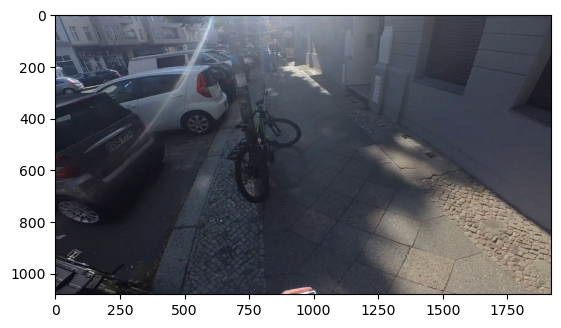

In [ ]:
f=a.get_frame_by_timestamp(5)
plt.imshow(f)

In [ ]:
import logging

for timestamp_index in range(0, 150):
    with plv.open(action_vid_path) as container:
        container.streams[0].logger.setLevel(logging.ERROR) # not this
        frame = container.streams[0].frames[timestamp_index]
        frame = frame.to_image()
        frame = np.asarray(frame) 

It looks like if we loop through the timestamps needed inside the opened container the RAM doesnt get eaten alive. It is the multiple call to opening the container that kills the RAM


Before kernel starts: 5.59G

After running the first two cells: 5.68G

Getting frames 0-149: 5.92G (Consumed .24G)

In [ ]:
import logging
container = plv.open(action_vid_path) 
container.streams[0].logger.setLevel(logging.ERROR) 
for timestamp_index in range(0, 150):
    frame = container.streams[0].frames[timestamp_index]
    frame = frame.to_image()
    frame = np.asarray(frame)

Before kernel starts: 5.66G

After running the first two cells: 5.72G

Getting frames 0-149: 5.87G (Consumed .15G)

In [ ]:
import logging
for timestamp_index in range(0, 150):
    with plv.open(action_vid_path) as container:
        container.streams[0].logger.setLevel(logging.ERROR) 
        frame = container.streams[0].frames


## Video Handler

In [ ]:
actionVid = VideoHandler(video_path=action_vid_path)
print(f'Action video:\n -Height: {actionVid.height}\n -Width: {actionVid.width}')
print(len(actionVid.timestamps))

Action video:
 -Height: 1080
 -Width: 1920
4338


In [ ]:
selected_timestamps=actionVid.get_timestamps_in_interval(0,5)
for i in selected_timestamps:
    action_frame = actionVid.get_frame_by_timestamp(i)

In [ ]:
neonVid=VideoHandler(video_path=neon_vid_path)
print(f'Neon video:\n -Height: {neonVid.height}\n -Width: {neonVid.width}')

Neon video:
 -Height: 1200
 -Width: 1600


(-0.1, 3.0)

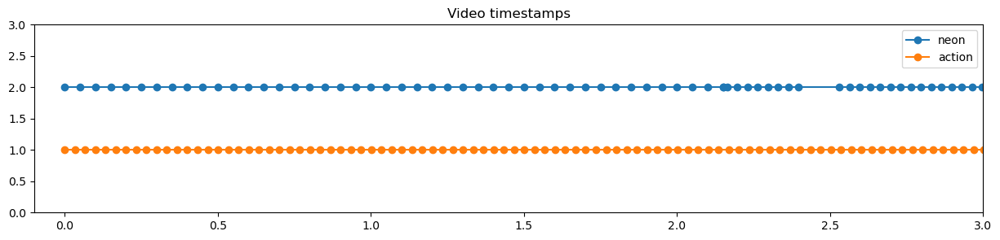

In [ ]:
plt.figure(figsize=(15,3))
plt.title('Video timestamps')
plt.plot(neonVid.timestamps,np.ones_like(neonVid.timestamps)*2,'-o',label='neon')
plt.plot(actionVid.timestamps,np.ones_like(actionVid.timestamps),'-o',label='action')
plt.legend()
plt.ylim(0,3)
plt.xlim(-0.1,3)

In [ ]:
neonVid.container.streams.video[0].average_rate.numerator/neonVid.container.streams.video[0].average_rate.denominator

29.84165234714625

In [ ]:
4359000/146071

29.84165234714625

In [ ]:
neonVid.container.streams.video[0].duration*neonVid.container.streams.video[0].average_rate.denominator

1920306333690

In [ ]:
neonVid.get_closest_timestamp(t)

In [ ]:
neon_timestamps= str(Path(neon_vid_path).parent / 'world_timestamps.csv')
action_timestamps= neon_timestamps.replace('world_timestamps.csv','action_camera_world_timestamps.csv')
action_timestamps= pd.read_csv(action_timestamps,dtype={'timestamp [ns]':np.float64})
neon_timestamps= pd.read_csv(neon_timestamps,dtype={'timestamp [ns]':np.float64})


neon_time=neon_timestamps['timestamp [ns]'].values
action_time=action_timestamps['timestamp [ns]'].values
action_time-=neon_timestamps['timestamp [ns]'].values[0]
neon_time-=neon_timestamps['timestamp [ns]'].values[0]
action_time/=1e9
neon_time/=1e9

for i,t in enumerate(action_time):
    print(f'Action timestamp {i}: {t} in video {actionVid.timestamps[i]}')
    print(f'Corresponding Neon timestamp: {neonVid.get_closest_timestamp(t)}')

Action timestamp 0: 0.630000128 in video 0.0
Corresponding Neon timestamp: 0.6499999761581421
Action timestamp 1: 0.663366912 in video 0.03336666524410248
Corresponding Neon timestamp: 0.6499999761581421
Action timestamp 2: 0.696733184 in video 0.06673333048820496
Corresponding Neon timestamp: 0.699999988079071
Action timestamp 3: 0.730099968 in video 0.10010000318288803
Corresponding Neon timestamp: 0.75
Action timestamp 4: 0.763466752 in video 0.1334666609764099
Corresponding Neon timestamp: 0.75
Action timestamp 5: 0.79683328 in video 0.1668333262205124
Corresponding Neon timestamp: 0.800000011920929
Action timestamp 6: 0.830200064 in video 0.20020000636577606
Corresponding Neon timestamp: 0.8500000238418579
Action timestamp 7: 0.863566592 in video 0.23356667160987854
Corresponding Neon timestamp: 0.8500000238418579
Action timestamp 8: 0.896933376 in video 0.2669333219528198
Corresponding Neon timestamp: 0.8999999761581421
Action timestamp 9: 0.93030016 in video 0.3003000020980835
C

In [ ]:
action_timestamps


'/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-16_wearingNeon/2024-02-16_15-58-13-6310bec3/action_camera_world_timestamps.csv'

Text(0.5, 1.0, 'Action')

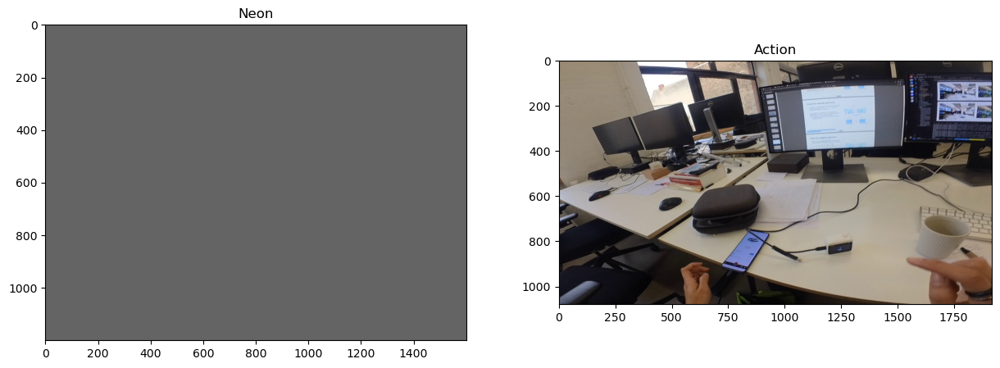

In [ ]:
neonframe = neonVid.get_frame_by_timestamp(neonVid.timestamps[0])
actionframe = actionVid.get_frame_by_timestamp(actionVid.timestamps[0])
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.title('Action')

## Optic Flow

In [ ]:
action_of = OpticFlowCalculatorFarneback(video_dir=action_vid_path)
neon_of = OpticFlowCalculatorFarneback(video_dir=neon_vid_path)

In [210]:
action_of = OpticFlowCalculatorLK(video_dir=action_vid_path)
neon_of = OpticFlowCalculatorLK(video_dir=neon_vid_path)

In [211]:
ac_result=action_of.process_video()
neon_result = neon_of.process_video()

(0.0, 25.0)

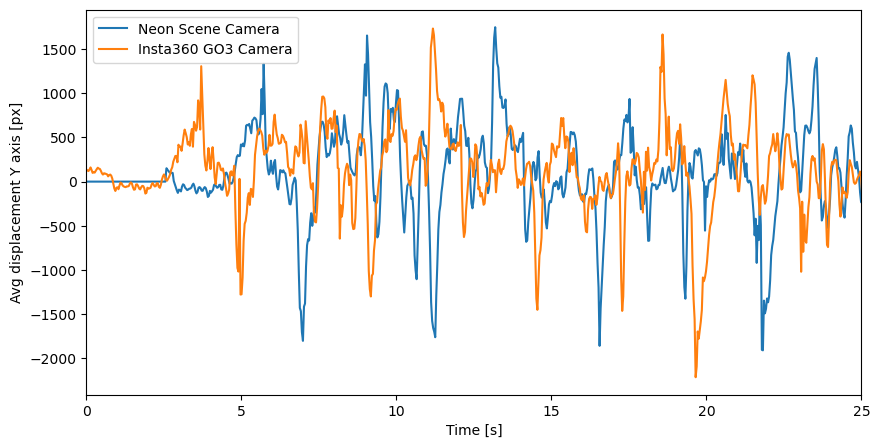

In [212]:
plt.figure(figsize=(10,5)) 
plt.plot(neon_result['start'].values,np.rad2deg(neon_result['dy'].values),label='Neon Scene Camera')
plt.plot(ac_result['start'].values,np.rad2deg(ac_result['dy'].values),label='Insta360 GO3 Camera')
plt.xlabel('Time [s]')
plt.ylabel('Avg displacement Y axis [px]')
plt.legend()
plt.xlim(0,25)

## Offset Calculator

In [ ]:
optic_flow_output_dir = Path(output_dir, 'optic_flow')
action_of_csv=Path(optic_flow_output_dir, 'action_lk_of.csv')
neon_of_csv=Path(optic_flow_output_dir, 'neon_lk_of.csv')
neon_opticflow = pd.read_csv(neon_of_csv,dtype=np.float32)
action_opticflow = pd.read_csv(action_of_csv,dtype=np.float32)

In [ ]:
start_time=8
timestamps=action_opticflow['start'].values
start_index = 0 if start_time is None else np.where(
            timestamps >= start_time)[0][0]
start_index2 = 0 if start_time is None else np.searchsorted(timestamps,start_time)
start_index,timestamps[start_index],start_index2,timestamps[start_index2]

(240, 8.008, 240, 8.008)

In [ ]:
end_time=10
end_index = None if end_time is None else np.where(
            timestamps <= end_time)[0][-1]
end_index2 = None if end_time is None else np.searchsorted(timestamps,end_time)
end_index,timestamps[end_index],end_index2,timestamps[end_index2]

(299, 9.976633, 300, 10.01)

In [ ]:
timestamps[start_index2:end_index2]

array([8.008    , 8.041367 , 8.074734 , 8.1081   , 8.141467 , 8.174833 ,
       8.2082   , 8.241567 , 8.274933 , 8.3083   , 8.341666 , 8.375033 ,
       8.4084   , 8.441767 , 8.475133 , 8.5085   , 8.541866 , 8.575233 ,
       8.6086   , 8.641967 , 8.675333 , 8.7087   , 8.742066 , 8.775434 ,
       8.8088   , 8.842167 , 8.875533 , 8.9089   , 8.942266 , 8.975634 ,
       9.009    , 9.042367 , 9.075733 , 9.1091   , 9.142467 , 9.175834 ,
       9.2092   , 9.242567 , 9.275933 , 9.3093   , 9.342667 , 9.376034 ,
       9.4094   , 9.442767 , 9.476133 , 9.5095   , 9.542867 , 9.576233 ,
       9.6096   , 9.642966 , 9.676333 , 9.7097   , 9.743067 , 9.776433 ,
       9.8098   , 9.843166 , 9.8765335, 9.9099   , 9.943267 , 9.976633 ],
      dtype=float32)

Estimated offset: 2.022 seconds (Pearson correlation: 0.8007462009778805)


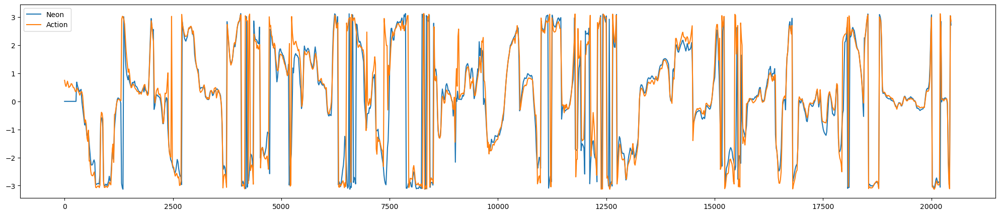

In [258]:
offset_calc=OffsetCalculator(src=ac_result['angle'].values,src_timestamps=ac_result['start'].values, dst=neon_result['angle'].values, dst_timestamps=neon_result['start'].values,resampling_frequency=500)
t_offset, pearson_corr = offset_calc.estimate_time_offset()
print(f'Estimated offset: {t_offset} seconds (Pearson correlation: {pearson_corr})')
start,end = None,None
idx=offset_calc._obtain_indexes(offset_calc.src_resampled_timestamps,start,end)
x_cor,lags=offset_calc._cross_correlate(offset_calc.src_resampled[idx[0]:idx[1]],offset_calc.dst_resampled)
s_offset = lags[np.argmax(x_cor)]
s,d=offset_calc._obtain_overlapping_signals(s_offset,offset_calc.src_resampled[idx[0]:idx[1]])
plt.figure(figsize=(25,5))
plt.plot(d,label='Neon')
plt.plot(s, label='Action')
plt.legend()


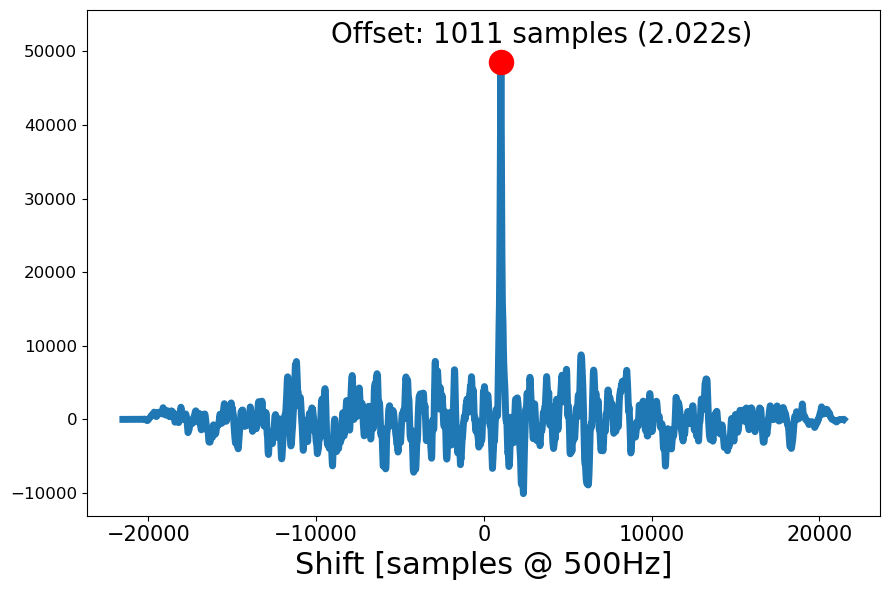

In [267]:
plt.figure(figsize=(9,6))
plt.plot(lags,x_cor,label='Cross-correlation',linewidth=5)
plt.scatter(s_offset,np.max(x_cor),color='red',zorder=2,s=300)
plt.xlabel(f'Shift [samples @ {offset_calc.resampling_frequency}Hz]',fontsize=22)
# plt.title('Cross-correlation between optic flow',fontsize=12)
plt.text(s_offset-10100,np.max(x_cor)+2500,f'Offset: {s_offset} samples ({s_offset/offset_calc.resampling_frequency}s)',color='black',fontsize=20)
plt.ylim(min(x_cor)-3000,max(x_cor)+7000)
# plt.xlim(-10000,10000)
plt.xticks(fontsize=15)
plt.yticks(fontsize=12)
plt.tight_layout()

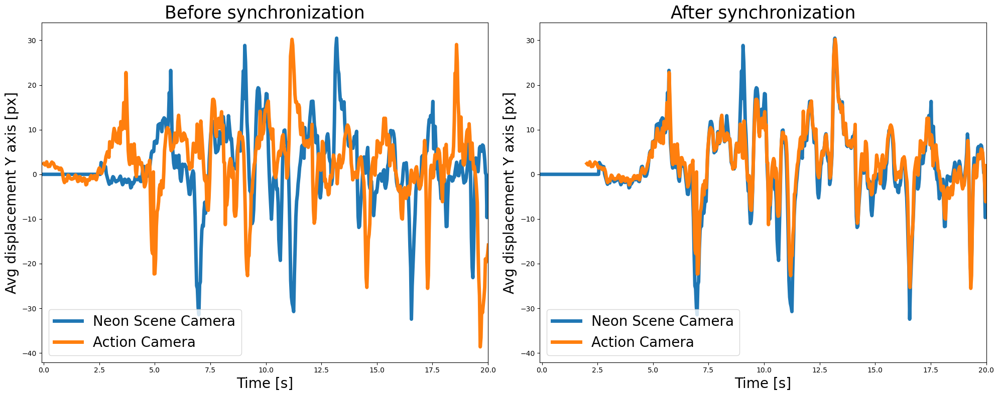

In [276]:
plt.figure(figsize=(20,8)) 
plt.subplot(1,2,1)
plt.plot(neon_result['start'].values,neon_result['dy'].values,label='Neon Scene Camera',linewidth=5)
plt.plot(ac_result['start'].values,ac_result['dy'].values,label='Action Camera',linewidth=5)
plt.xlabel('Time [s]',fontsize=20)
plt.ylabel('Avg displacement Y axis [px]',fontsize=20)
plt.legend(fontsize=20,loc='lower left')
plt.xlim(-0.1,20)
plt.title ('Before synchronization',fontsize=25)
plt.subplot(1,2,2)
plt.plot(neon_result['start'].values,neon_result['dy'].values,label='Neon Scene Camera',linewidth=5)
plt.plot(ac_result['start'].values+t_offset,ac_result['dy'].values,label='Action Camera',linewidth=5)
plt.xlim(-0.1,20)
plt.xlabel('Time [s]',fontsize=20)
plt.ylabel('Avg displacement Y axis [px]',fontsize=20)
plt.legend(fontsize=20,loc='lower left')
plt.title (f'After synchronization',fontsize=25)
plt.tight_layout()

Estimated offset: 4.074 seconds (Pearson correlation: 0.8035807021686995)


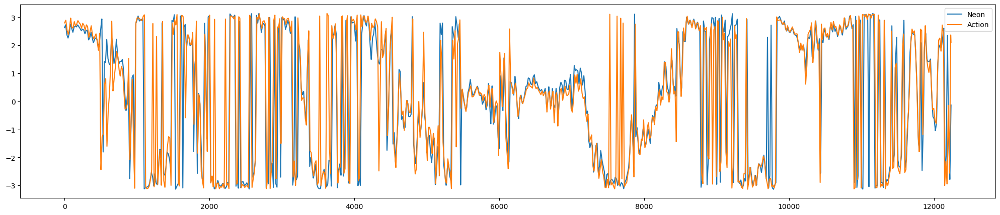

In [ ]:
start,end = 1.5,None
t_offset, pearson_corr = offset_calc.estimate_time_offset(source_end_time=end, source_start_time=start)
print(f'Estimated offset: {t_offset} seconds (Pearson correlation: {pearson_corr})')
idx=offset_calc._obtain_indexes(offset_calc.src_resampled_timestamps,start,end)
x_cor,lags=offset_calc._cross_correlate(offset_calc.src_resampled[idx[0]:idx[1]])
s_offset = lags[np.argmax(x_cor)]
s,d=offset_calc._obtain_overlapping_signals(s_offset,offset_calc.src_resampled[idx[0]:idx[1]])
plt.figure(figsize=(25,5))
plt.plot(d, label='Neon')
plt.plot(s,label='Action')
plt.legend()

Comparing it with the previously calculated optic flow signal 

In [ ]:
previous_optic_flow_path = '/users/sof/gaze_mapping/synchronization/optic_flow/my_desk_unstable_grid_opticflow.pkl'

Insert here the path to the saved optic flow of the corresponding pair of videos

Start of Optic Flow in neon video: 1.435744256s (frame number 30)
Start of Optic Flow in action video: 0.03336666666666667s (frame number 1)


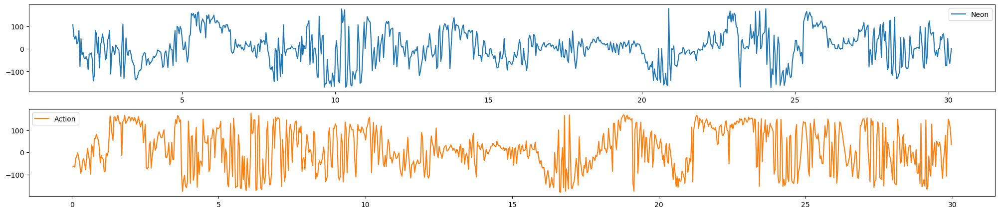

In [ ]:
optic=pd.read_pickle(previous_optic_flow_path)
neon_optic=pd.DataFrame({k:v for k,v in optic.items() if 'neon' in k})
action_optic=pd.DataFrame({k:v for k,v in optic.items() if 'action' in k})
df = pd.read_csv(neon_timestamps)
t_neon = df["timestamp [ns]"].values.astype(np.float64)
t_neon -= t_neon[0]
t_neon /= 1e9
#timestamps for action cam video
recording_action = plv.open(action_vid_path)
pts_action = np.asarray(recording_action.streams[0].pts)
t_action=pts_action/recording_action.streams[0].time_base.denominator
print(f'Start of Optic Flow in neon video: {t_neon[neon_optic["neon frame"].iloc[0]]}s (frame number {neon_optic["neon frame"].iloc[0]})')
print(f'Start of Optic Flow in action video: {t_action[action_optic["action frame"].iloc[0]]}s (frame number {action_optic["action frame"].iloc[0]})')
useful_t_neon = t_neon[neon_optic['neon frame'].iloc[0]:neon_optic['neon frame'].iloc[-1]+1]
useful_t_action = t_action[action_optic['action frame'].iloc[0]:action_optic['action frame'].iloc[-1]+1]

plt.figure(figsize=(25,5)) 
plt.subplot(2,1,1)
plt.plot(useful_t_neon,neon_optic['neon angle'],label='Neon')
plt.legend()
plt.subplot(2,1,2)
plt.plot(useful_t_action,action_optic['action angle'],color=mcolors.TABLEAU_COLORS['tab:orange'],label='Action')
plt.legend()

Estimated offset: 4.076377589333333 seconds (Pearson correlation: 0.8170644954095271)
Estimated offset: 4.07237758933333 seconds (Pearson correlation: 0.8152398134184627)


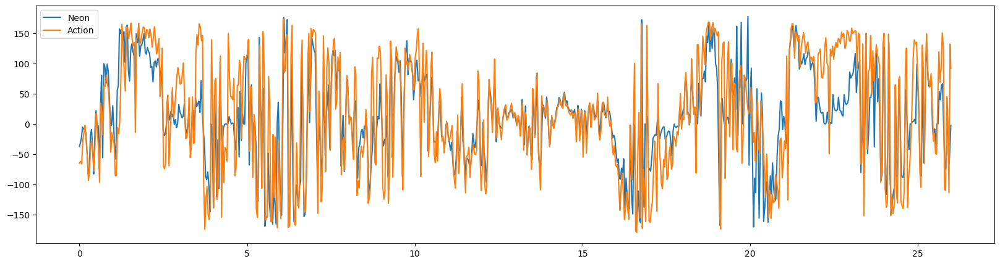

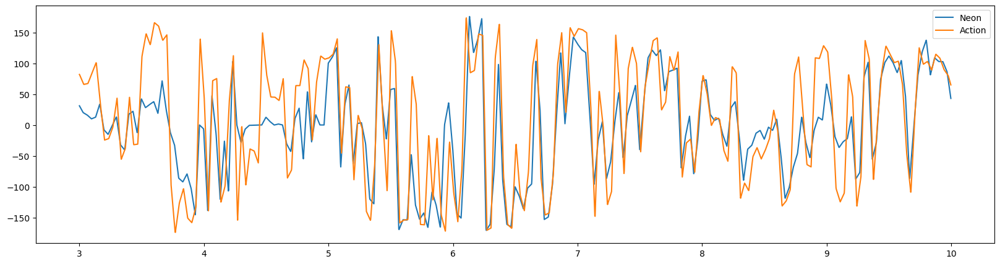

In [ ]:
offset_calc2 = OffsetCalculator(src=action_optic['action angle'].values,src_timestamps=useful_t_action, dst=neon_optic['neon angle'].values, dst_timestamps = useful_t_neon,resampling_frequency=500)
t_offset,pearson_corr = offset_calc2.estimate_time_offset()
print(f'Estimated offset: {t_offset} seconds (Pearson correlation: {pearson_corr})')

start,end = None,None
idx=offset_calc2._obtain_indexes(offset_calc2.src_resampled_timestamps,start,end)
x_cor,lags=offset_calc2._cross_correlate(offset_calc2.src_resampled[idx[0]:idx[1]])
s_offset = lags[np.argmax(x_cor)]
s,d=offset_calc2._obtain_overlapping_signals(s_offset,offset_calc2.src_resampled[idx[0]:idx[1]])
plt.figure(figsize=(20,5))
plt.plot(np.arange(len(d))/offset_calc2.resampling_frequency,d, label='Neon')
plt.plot(np.arange(len(s))/offset_calc2.resampling_frequency,s,label='Action')
plt.legend()

start,end = 3,10
t_offset,pearson_corr = offset_calc2.estimate_time_offset(source_end_time=end, source_start_time=start)
print(f'Estimated offset: {t_offset} seconds (Pearson correlation: {pearson_corr})')
idx=offset_calc2._obtain_indexes(offset_calc2.src_resampled_timestamps,start,end)
x_cor,lags=offset_calc2._cross_correlate(offset_calc2.src_resampled[idx[0]:idx[1]])
s_offset = lags[np.argmax(x_cor)]
s,d=offset_calc2._obtain_overlapping_signals(s_offset,offset_calc2.src_resampled[idx[0]:idx[1]])
plt.figure(figsize=(20,5))
plt.plot(np.arange(len(d))/offset_calc2.resampling_frequency+start,d, label='Neon')
plt.plot(np.arange(len(s))/offset_calc2.resampling_frequency+start,s,label='Action')
plt.legend()


## Creation of action_world_timestamps.csv

In [ ]:
#write_worldtimestamp_csv(world_timestamps_dir=neon_timestamps, relative_timestamps=actionVid.timestamps, time_delay=t_offset)
neon_worldts = pd.read_csv(neon_timestamps)
action_worldts = pd.read_csv(neon_timestamps.replace('world_timestamps.csv','action_camera_world_timestamps.csv'))

(1.708095493929e+18, 1.7080955046945e+18)

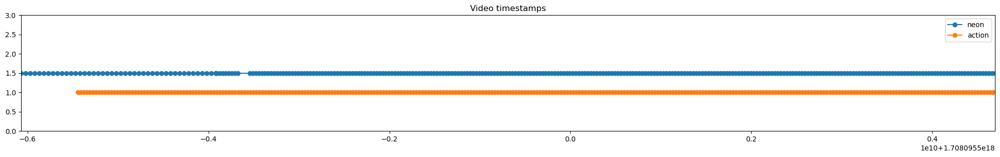

In [ ]:
plt.figure(figsize=(25,3))
plt.title('Video timestamps')
plt.plot(neon_worldts['timestamp [ns]'].values,np.ones_like(neon_worldts['timestamp [ns]'].values)*1.5,'-o',label='neon')
plt.plot(action_worldts['timestamp [ns]'].values,np.ones_like(action_worldts['timestamp [ns]'].values),'-o',label='action')
plt.legend()
plt.ylim(0,3)
plt.xlim(neon_worldts['timestamp [ns]'].values[0],neon_worldts['timestamp [ns]'].values[300])

If we take a random world timestamp from the Neon Scene recording, the action worldtimestamp dataframe can be queried to obtain the index of the closest action worldtimestamp. (Datetime printed just to show it is indeed the closest frame in the other video)

In [ ]:
neon_idx=200
random_neon_ts=neon_worldts['timestamp [ns]'].values[neon_idx]

index_action=np.argmin(np.abs(action_worldts['timestamp [ns]'].values - random_neon_ts))
corresponding_action_ts = action_worldts['timestamp [ns]'].iloc[index_action]

print(f"Neon date.time: {pd.Timestamp(random_neon_ts,unit='ns')}, at index {neon_idx}")
print(f"Action date.time: {pd.Timestamp(corresponding_action_ts,unit='ns')}, at index {index_action}")

Neon date.time: 2024-02-16 14:58:21.360255555, at index 200
Action date.time: 2024-02-16 14:58:21.365800, at index 204


Text(0.5, 1.0, 'Action')

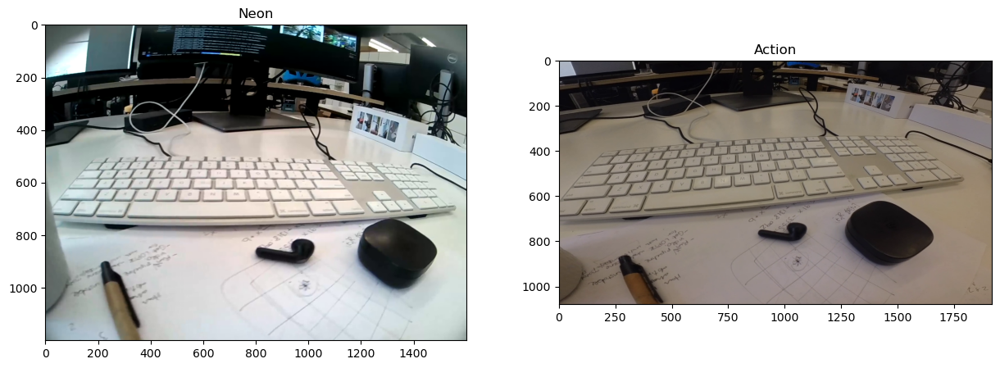

In [ ]:
actionVid = VideoHandler(video_path=action_vid_path)
neonVid=VideoHandler(video_path=neon_vid_path)

neonframe = neonVid.get_frame_by_timestamp(neonVid.timestamps[neon_idx])
actionframe = actionVid.get_frame_by_timestamp(actionVid.timestamps[index_action])
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.title('Action')

Even easier, we can take advantage of the get_closest_timestamp method in VideoHandler.

Given two world_timestamp files, the delay between the videos can be recovered. 
Throughout all the project, the Neon recording is treated as the 'relative zero'. So to get the neon relative timestamp, it is just enough with substracting the first neon worldtimestamp value and then converting it to seconds.

The action worldtimestamps were calculated by adding the offset value given by the OffsetCalculator() to the action relative timestamps and then adding the first neon worldtimestamp value. So to recover the offset, it just suffices to substract the value of the first Neon worldtimestamp to the first action worldtimestamp value and then converting it to seconds.

So with the action offset value, it is as simple as substracting this offset to the neon relative timestamp and giving the resulting value to the get_frame_by_timestamp method of the action VideoHandler (THIS METHOD CALLS INTERNALLY FOR get_closest_timestamp).

In [ ]:
random_neon_relative_ts=(random_neon_ts-neon_worldts['timestamp [ns]'].values[0])/1e9
print(f'Random relative neon timestamp: {random_neon_relative_ts}s')
action_offset =  action_worldts['timestamp [ns]'].values[0] - neon_worldts['timestamp [ns]'].values[0]
action_offset/=1e9
#print(f'Offset from the csv files: {action_offset}s\nOffset from the offset_calculator: {t_offset}s')

Random relative neon timestamp: 7.431255555s


a.Time value found by querying the action worldtimestamps dataframe: 6.80679988861084
b.This time value is given to the actionVid object: 6.801255555
c.Time value found by giving value in b to get_closest_timestamp in the actionVid object: 6.80679988861084


Text(0.5, 1.0, 'Action')

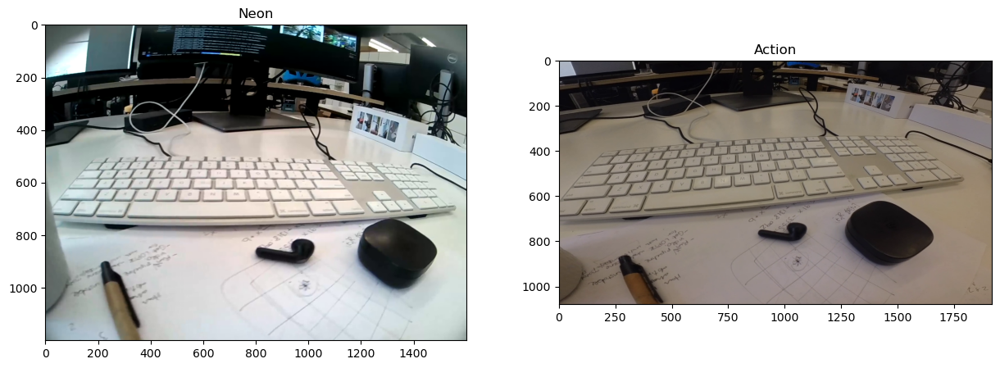

In [ ]:
actionVid = VideoHandler(video_path=action_vid_path)
neonVid=VideoHandler(video_path=neon_vid_path)

print(f'a.Time value found by querying the action worldtimestamps dataframe: {actionVid.timestamps[index_action]}')
print(f'b.This time value is given to the actionVid object: {random_neon_relative_ts-action_offset}')
print(f'c.Time value found by giving value in b to get_closest_timestamp in the actionVid object: {actionVid.get_closest_timestamp(random_neon_relative_ts-action_offset)}')
neonframe = neonVid.get_frame_by_timestamp(random_neon_relative_ts)
actionframe = actionVid.get_frame_by_timestamp(random_neon_relative_ts-action_offset)
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.title('Action')

## DISK+LIGHTGLUE

In [ ]:
from feature_matcher import ImageMatcherFactory

actionVid = VideoHandler(video_path=action_vid_path)
neonVid=VideoHandler(video_path=neon_vid_path)
neonframe = neonVid.get_frame_by_timestamp(neonVid.timestamps[45])
actionframe = actionVid.get_frame_by_timestamp(neonVid.timestamps[45]-action_offset)
lg_param={'num_features':2048,'gpu_num':0}
matcher = ImageMatcherFactory('DISK_LIGHTGLUE',lg_param).get_matcher()

Loaded LightGlue model


In [ ]:
point_gaze= np.array([1000,  800])
patch_corners = office_desk_mapper._get_patch_corners(1000,point_gaze,neonframe.shape)
correspondences=matcher.get_correspondences(neonframe,actionframe,patch_corners)

/cluster/anaconda3/envs/sof_gazemapping/lib/python3.11/site-packages/torchvision/transforms/functional.py:152: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /opt/conda/conda-bld/pytorch_1702400430266/work/torch/csrc/utils/tensor_numpy.cpp:206.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


torch.Size([1, 3, 1000, 1000]) torch.Size([1, 3, 1080, 1920])


keypoints0: (283, 2)
keypoints1: (283, 2)
confidence: (283,)


Text(0.5, 1.0, 'Action')

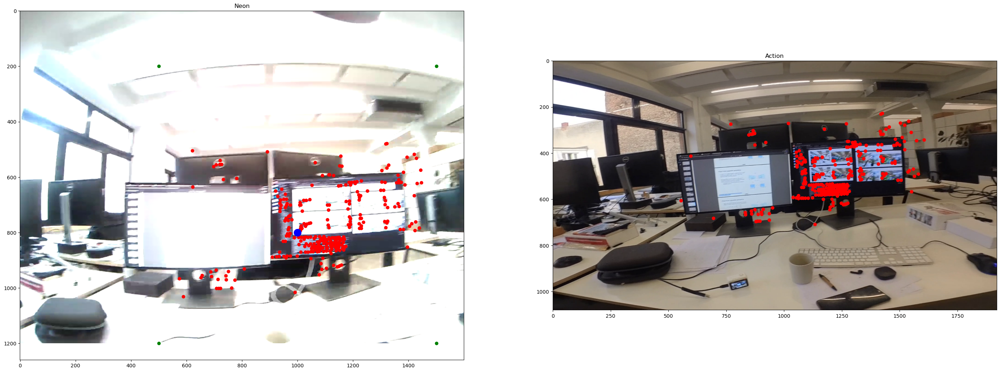

In [ ]:
for k in correspondences.keys():
    print(f'{k}: {correspondences[k].shape}')
plt.figure(figsize=(35,25))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.scatter(correspondences['keypoints0'][:,0],correspondences['keypoints0'][:,1],color='r')
plt.scatter(patch_corners[:,0],patch_corners[:,1],color='g')
plt.scatter(point_gaze[0],point_gaze[1],color='b',s=205)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.scatter(correspondences['keypoints1'][:,0],correspondences['keypoints1'][:,1],color='r')
plt.title('Action')

## LOFTR

In [ ]:
from  feature_matcher import ImageMatcherFactory
actionVid = VideoHandler(video_path=action_vid_path)
neonVid=VideoHandler(video_path=neon_vid_path)
neonframe = neonVid.get_frame_by_timestamp(neonVid.timestamps[45])
actionframe = actionVid.get_frame_by_timestamp(neonVid.timestamps[45]-action_offset)
param={'location':'indoor', 'gpu_num':0}
loftr_matcher=ImageMatcherFactory('loftr',param).get_matcher()

In [ ]:
print(param)

{'location': 'indoor', 'gpu_num': 0}


Number of correspondences: 4


Text(0.5, 1.0, 'Action')

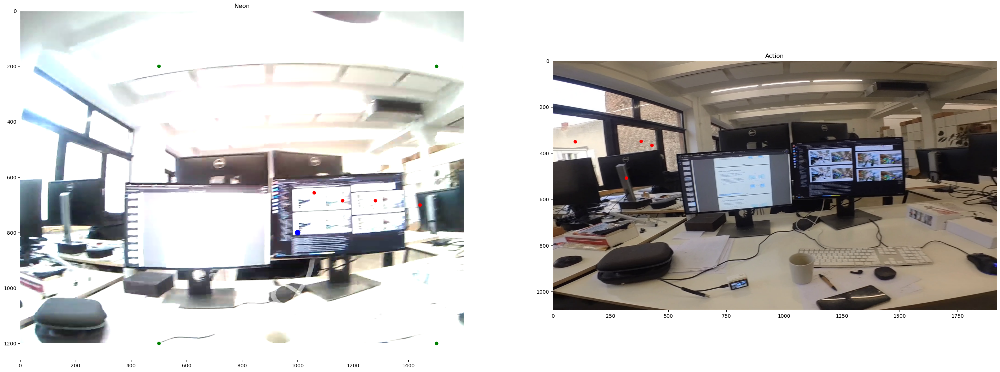

In [ ]:
point_gaze= np.array([1000,  800])
patch_corners = office_desk_mapper._get_patch_corners(1000,point_gaze,neonframe.shape)
correspondences=loftr_matcher.get_correspondences(neonframe,actionframe,patch_corners)
print(f'Number of correspondences: {len(correspondences["keypoints0"])}')
plt.figure(figsize=(35,25))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.scatter(correspondences['keypoints0'][:,0],correspondences['keypoints0'][:,1],color='r')
plt.scatter(patch_corners[:,0],patch_corners[:,1],color='g')
plt.scatter(point_gaze[0],point_gaze[1],color='b',s=105)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.scatter(correspondences['keypoints1'][:,0],correspondences['keypoints1'][:,1],color='r')
plt.title('Action')

In [ ]:
import cv2 as cv

neon_pts = np.float32(correspondences['keypoints0']).reshape(-1, 1, 2)
action_pts = np.float32(correspondences['keypoints1']).reshape(-1, 1, 2)
transformation, mask = cv.findHomography(neon_pts, action_pts, cv.RANSAC, 5.0)
point_to_be_transformed = np.float32(point_gaze).reshape(-1, 1, 2)
transformed_point = cv.perspectiveTransform(
    point_to_be_transformed, transformation)
transformed_point=transformed_point.reshape(-1)
print(f'Transformed point: {transformed_point}')

Transformed point: [695.69385 712.9747 ]


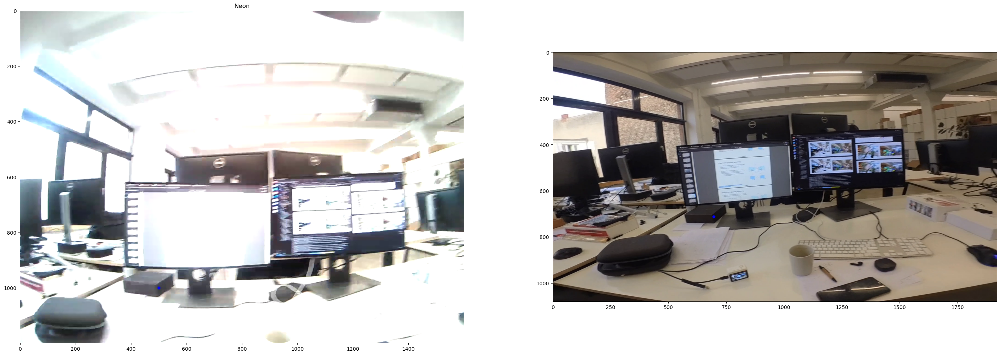

In [ ]:
plt.figure(figsize=(35,25))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.scatter(point_gaze[0],point_gaze[1],color='b',s=25)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.scatter(transformed_point[0],transformed_point[1],color='b',s=25)

In [ ]:
image_shape = neonframe.shape
point_to_be_transformed = point_gaze

In [ ]:
def filter(image_shape,correspondences,point_to_be_transformed,loftr_matcher):
    prev_patch_size = loftr_matcher.patch_size
    prev_patch_corners = loftr_matcher.patch_corners
    while True:
        new_patch_size = prev_patch_size - 100
        new_patch_corners = loftr_matcher._get_patch_corners(new_patch_size, point_to_be_transformed, image_shape)
        kept_kp_index=[]
        for i, kp in enumerate(correspondences['keypoints0']):
            if min(new_patch_corners[:,0])<kp[0]<max(new_patch_corners[:,0]) and min(new_patch_corners[:,1])<kp[1]<max(new_patch_corners[:,1]):
                kept_kp_index.append(i)
        print(len(kept_kp_index))
        if len(kept_kp_index) < 100: 
            return correspondences, prev_patch_corners
        for k in correspondences.keys():
            correspondences[k]=correspondences[k][kept_kp_index]
        print(f'Number of correspondences in neighborhood of  {new_patch_size}: {len(correspondences["keypoints0"])}')
        prev_patch_corners = new_patch_corners
        prev_patch_size = new_patch_size
        if new_patch_size == 100:
            return correspondences, prev_patch_corners
        

In [ ]:
filt_correspondences, new_patch_corners=filter(image_shape,correspondences,point_to_be_transformed,loftr_matcher)

1315
Number of correspondences in neighborhood of  900: 1315
1134
Number of correspondences in neighborhood of  800: 1134
894
Number of correspondences in neighborhood of  700: 894
714
Number of correspondences in neighborhood of  600: 714
494
Number of correspondences in neighborhood of  500: 494
356
Number of correspondences in neighborhood of  400: 356
216
Number of correspondences in neighborhood of  300: 216
81


Text(0.5, 1.0, 'Action')

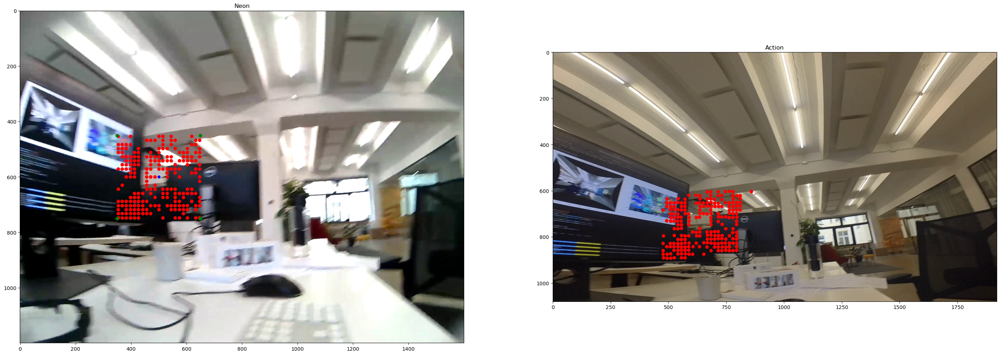

In [ ]:
plt.figure(figsize=(35,25))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.scatter(filt_correspondences['keypoints0'][:,0],filt_correspondences['keypoints0'][:,1],color='r')
plt.scatter(new_patch_corners[:,0],new_patch_corners[:,1],color='g')
plt.scatter(point_gaze[0],point_gaze[1],color='b',s=25)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.scatter(filt_correspondences['keypoints1'][:,0],filt_correspondences['keypoints1'][:,1],color='r')
plt.title('Action')

[651.46643 743.9187 ]


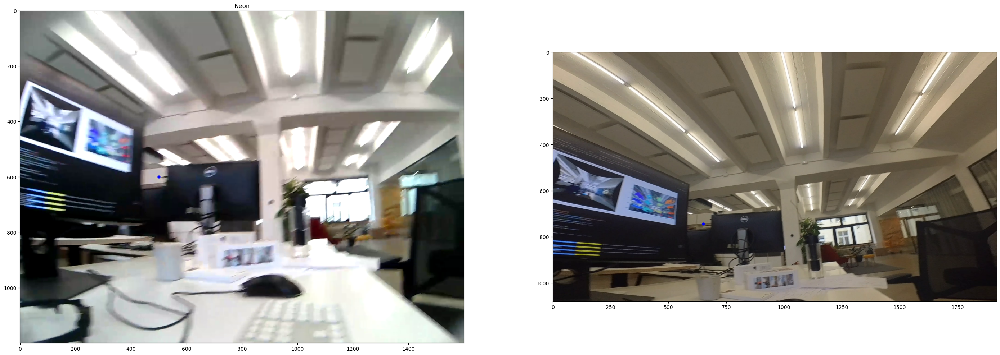

In [ ]:
neon_pts = np.float32(filt_correspondences['keypoints0']).reshape(-1, 1, 2)
action_pts = np.float32(filt_correspondences['keypoints1']).reshape(-1, 1, 2)
transformation, mask = cv.findHomography(neon_pts, action_pts, cv.RANSAC, 5.0)
point_to_be_transformed = np.float32(point_gaze).reshape(-1, 1, 2)
transformed_point = cv.perspectiveTransform(
    point_to_be_transformed, transformation)
transformed_point=transformed_point.reshape(-1)
print(transformed_point)
plt.figure(figsize=(35,25))
plt.subplot(1,2,1)
plt.imshow(neonframe)
plt.scatter(point_gaze[0],point_gaze[1],color='b',s=25)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(actionframe)
plt.scatter(transformed_point[0],transformed_point[1],color='b',s=25)

## Gaze Mapper

In [187]:
# action_vid_path='/users/sof/gaze_mapping/raw_videos/InstaVid/computer_10s/AVun_20240209_151742_032.mp4'
# neon_vid_path='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-09_computer/2024-02-09_14-45-16-80495056/47d4b0cc_0.0-12.177.mp4'
# neon_timestamps='/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-09_computer/2024-02-09_14-45-16-80495056/world_timestamps.csv'


output_dir='/users/sof/action_map_experiments/new_mapper/second_video_2'
action_timestamps= Path(neon_timeseries_path, 'action_camera_timestamps.csv')
optic_flow_output_dir = Path(output_dir, 'optic_flow')
action_of_csv=Path(optic_flow_output_dir, 'action_lk_of.csv')
neon_of_csv=Path(optic_flow_output_dir, 'neon_lk_of.csv')

neon_gaze_csv=Path(neon_timeseries_path, 'gaze.csv')
neon_timestamps= Path(neon_timeseries_path, 'world_timestamps.csv')
param_lg = {'num_features':2048,'gpu_num':0}
param_loftr = {'location':'outdoor', 'gpu_num':0}
image_matcher_loftr={'choice':'loftr','parameters':param_loftr}
image_matcher_lg={'choice':'disk_lightglue','parameters':param_lg}

image_matcher=image_matcher_loftr

In [188]:
mapper = ActionCameraGazeMapper(neon_gaze_csv=neon_gaze_csv,
        neon_video_dir=neon_vid_path,
        action_video_dir=action_vid_path,
        neon_timestamps=neon_timestamps,
        action_timestamps=action_timestamps,
        image_matcher=image_matcher['choice'],
        image_matcher_parameters=image_matcher['parameters'],
        neon_opticflow_csv=neon_of_csv,
        action_opticflow_csv=action_of_csv,
        patch_size=1000)

ISSUE: If I run the mapper on my local computer I get a 

In [9]:
for i, gaze_world_ts in enumerate(mapper.action_gaze["timestamp [ns]"].values[84:],start=84):
        gaze_neon = mapper.neon_gaze.loc[mapper.neon_gaze["timestamp [ns]"] == gaze_world_ts,["gaze x [px]", "gaze y [px]"]].values.reshape(1, 2)
        gaze_relative_timestamp = (gaze_world_ts - mapper.neon_ts["timestamp [ns]"].values[0]) / 1e9
        neon_timestamp,i_neon = mapper.neon_video.get_closest_timestamp(gaze_relative_timestamp)
        action_timestamp = mapper.action_video.get_closest_timestamp(neon_timestamp - mapper.action2neon_offset)[0]
        print(f'Gaze relative timestamp: {gaze_relative_timestamp}')
        print(i_neon,neon_timestamp,action_timestamp) 
        if mapper._gaze_between_video_frames(gaze_world_ts):
                semantically_correct_gaze = mapper._move_point_to_video_timestamp(gaze_neon,gaze_relative_timestamp,neon_timestamp,mapper.neon_opticflow)
                gaze_action_camera = mapper._map_one_gaze(semantically_correct_gaze, neon_timestamp, action_timestamp)
                print(f'AC gaze: {gaze_action_camera}')
                gaze_action_camera = mapper._move_point_to_arbitrary_timestamp(gaze_action_camera,action_timestamp, mapper.action_opticflow,gaze_relative_timestamp-mapper.action2neon_offset)
        else:   
                gaze_action_camera = mapper._map_one_gaze(
                        gaze_neon, neon_timestamp, action_timestamp
                )
        print(f"({i}) Gaze ({gaze_neon}) at {gaze_world_ts} mapped to {gaze_action_camera}")
        if i==124:
                break

Gaze relative timestamp: 2.563591454
52 2.5715334 0.5672333
AC gaze: [[963.104   588.22375]]
(84) Gaze ([[827.629 853.611]]) at 1716475658323591454 mapped to [[960.92957 587.4056 ]]
Gaze relative timestamp: 2.568596454
52 2.5715334 0.5672333
AC gaze: [[964.55664 621.8265 ]]
(85) Gaze ([[826.624 894.433]]) at 1716475658328596454 mapped to [[962.9363 621.2168]]
Gaze relative timestamp: 2.573591454
52 2.5715334 0.5672333
AC gaze: [[950.8054 658.0053]]
(86) Gaze ([[812.936 938.544]]) at 1716475658333591454 mapped to [[949.73804 657.6037 ]]
Gaze relative timestamp: 2.578597454
53 2.5839667 0.5672333
AC gaze: [[953.4905 650.7322]]
(87) Gaze ([[814.375 927.914]]) at 1716475658338597454 mapped to [[952.97723 650.53906]]
Gaze relative timestamp: 2.583591454
53 2.5839667 0.5672333
AC gaze: [[965.21136 640.6639 ]]
(88) Gaze ([[831.053 918.017]]) at 1716475658343591454 mapped to [[965.2459 640.6815]]
Gaze relative timestamp: 2.588591454
53 2.5839667 0.5672333
AC gaze: [[972.5288  645.72906]]
(89) 

1458,

In [347]:
for gaze_world_ts in mapper.action_gaze['timestamp [ns]'].values[2100:]:
    gaze_neon=mapper.neon_gaze.loc[mapper.neon_gaze['timestamp [ns]']==gaze_world_ts,['gaze x [px]', 'gaze y [px]']].values.reshape(1,2)
    gaze_relative_timestamp = (gaze_world_ts - mapper.neon_ts['timestamp [ns]'].values[0])/1e9
    print(f'Gaze relative timestamp: {gaze_relative_timestamp}')
    neon_timestamp,i_neon = mapper.neon_video.get_closest_timestamp(gaze_relative_timestamp)
    action_timestamp = mapper.action_video.get_closest_timestamp(neon_timestamp-mapper.action2neon_offset)[0]
    print(i_neon,neon_timestamp,action_timestamp)
    if mapper._gaze_between_video_frames(gaze_world_ts):
        semantically_correct_gaze = mapper._move_point_to_video_timestamp(gaze_neon, gaze_relative_timestamp, neon_timestamp, mapper.neon_opticflow)
        gaze_action_camera = mapper._map_one_gaze(
                    semantically_correct_gaze, neon_timestamp, action_timestamp)
        print(f'Gaze in neon camera: {gaze_neon}')
        print(f'Gaze in action camera: {gaze_action_camera}')
        gaze_action_camera = mapper._move_point_to_arbitrary_timestamp(gaze_action_camera,action_timestamp,mapper.action_opticflow,gaze_world_ts)
        print(f'Gaze in action camera: {gaze_action_camera}')

    action_frame = mapper.action_video.get_frame_by_timestamp(action_timestamp)
    neon_frame = mapper.neon_video.get_frame_by_timestamp(neon_timestamp)
    if np.all(neon_frame==100):
        print(f'Neon frame at {neon_timestamp} is all gray')
    patch_corners = mapper._get_patch_corners(mapper.patch_size,semantically_correct_gaze, neon_frame.shape)
    correspondences = mapper.image_matcher.get_correspondences(
            neon_frame, action_frame, patch_corners)
    print(f'Number of correspondences: {len(correspondences["keypoints0"])} at {abs(patch_corners[0,0]-patch_corners[2,0])} patch size')
    correspondences, new_patch_corners = mapper._filter_correspondences(correspondences.copy(), semantically_correct_gaze, neon_frame.shape)
    print(f'Number of correspondences: {len(correspondences["keypoints0"])} at {abs(new_patch_corners[0,0]-new_patch_corners[2,0])} patch size')
    gaze_in_action_camera=mapper._transform_point(correspondences,semantically_correct_gaze)
    print(f'Gaze in action camera: {gaze_in_action_camera}')

    break

Gaze relative timestamp: 12.667970454
353 12.653378 10.643967
Gaze in neon camera: [[853.172 913.704]]
Gaze in action camera: [[986.3147  632.95703]]
Gaze in action camera: [[-1.3494492e+20  2.1787915e+20]]
Number of correspondences: 2087 at 1000 patch size
Number of correspondences: 103 at 200 patch size
Gaze in action camera: [[986.3147  632.95703]]


In [306]:
mapper2 = ActionCameraGazeMapper2(neon_gaze_csv=neon_gaze_csv,
        neon_video_dir=neon_vid_path,
        action_video_dir=action_vid_path,
        neon_timestamps=neon_timestamps,
        action_timestamps=action_timestamps,
        image_matcher=image_matcher['choice'],
        image_matcher_parameters=image_matcher['parameters'],
        neon_opticflow_csv=neon_of_csv,
        action_opticflow_csv=action_of_csv,
        patch_size=1000)

In [33]:
neon_start_idx=mapper2.neon_video.get_closest_timestamp((mapper2.action_gaze['timestamp [ns]'].values[0]-mapper2.neon_ts['timestamp [ns]'].values[0])/1e9)[1]
for i,neon_ts in enumerate(mapper2.neon_ts['timestamp [ns]'].values[1262:],start=1262):
    lower_bound = neon_ts-(neon_ts-mapper2.neon_ts['timestamp [ns]'].values[i-1])/2 if i>0 else 0
    upper_bound = neon_ts+(mapper2.neon_ts['timestamp [ns]'].values[i+1]-neon_ts)/2 if i<len(mapper2.neon_ts['timestamp [ns]'].values)-1 else np.inf
    gazes_for_this_frame = mapper2.action_gaze.loc[mapper2.action_gaze['timestamp [ns]'].between(lower_bound,upper_bound,inclusive='left')]
    
    
    neon_relative_ts=mapper2.neon_video.timestamps[i]
    action_relative_ts=mapper2.action_video.timestamps[mapper2.corresponding_action_idx[i]]

    print(f'({i}) Mapping {len(gazes_for_this_frame)} gazes from neon frame at {neon_ts}({neon_relative_ts}) to action camera frame at {mapper2.action_ts["timestamp [ns]"].values[mapper2.corresponding_action_idx[i]]}({action_relative_ts})')

    neon_frame = mapper2.neon_video.get_frame_by_timestamp(neon_relative_ts)
    action_frame = mapper2.action_video.get_frame_by_timestamp(action_relative_ts)
    for gaze_ts in gazes_for_this_frame['timestamp [ns]'].values:
        gaze_neon=mapper2.neon_gaze.loc[mapper2.neon_gaze['timestamp [ns]']==gaze_ts,['gaze x [px]', 'gaze y [px]']].values.reshape(1,2)
        gaze_relative_ts = (gaze_ts - mapper2.neon_ts['timestamp [ns]'].values[0])/1e9
        if mapper2._gaze_between_video_frames(gaze_ts):
            semantic_gaze = mapper2._move_point_to_video_timestamp(gaze_neon, gaze_relative_ts, neon_relative_ts, mapper2.neon_opticflow)
            gaze_action_camera = mapper2._map_one_gaze(semantic_gaze, neon_frame, action_frame)[0]
            gaze_action_camera = mapper2._move_point_to_arbitrary_timestamp(gaze_action_camera,action_relative_ts,mapper2.action_opticflow,gaze_ts)
        else:
            gaze_action_camera = mapper2._map_one_gaze(gaze_neon, neon_frame, action_frame)[0]
        print(f'- Gaze ({gaze_neon}) at {gaze_relative_ts} mapped to {gaze_action_camera}')
    if i==258:
        break

(1262) Mapping 8 gazes from neon frame at 1716475698721666666(42.961666107177734) to action camera frame at 1716475698716898304(40.94089889526367)
Number of correspondences: 229 at 300 patch size
- Gaze ([[ 812.989 1229.814]]) at 42.946106454 mapped to [[-1.14341645e+20  1.20053608e+20]]
Number of correspondences: 221 at 300 patch size
- Gaze ([[ 818.521 1231.398]]) at 42.951106454 mapped to [[-1.14341645e+20  1.20053608e+20]]
Number of correspondences: 221 at 300 patch size
- Gaze ([[ 818.267 1232.853]]) at 42.956105454 mapped to [[-1.14341645e+20  1.20053608e+20]]
Number of correspondences: 217 at 300 patch size
- Gaze ([[ 818.065 1231.633]]) at 42.961106454 mapped to [[-1.14341645e+20  1.20053608e+20]]
Number of correspondences: 229 at 300 patch size
- Gaze ([[ 810.818 1232.419]]) at 42.966105454 mapped to [[960.839  910.8035]]
Number of correspondences: 229 at 300 patch size
- Gaze ([[ 811.775 1226.075]]) at 42.971106454 mapped to [[958.69525 893.8579 ]]
Number of correspondences: 

(-0.5, 1599.5, 1199.5, -0.5)

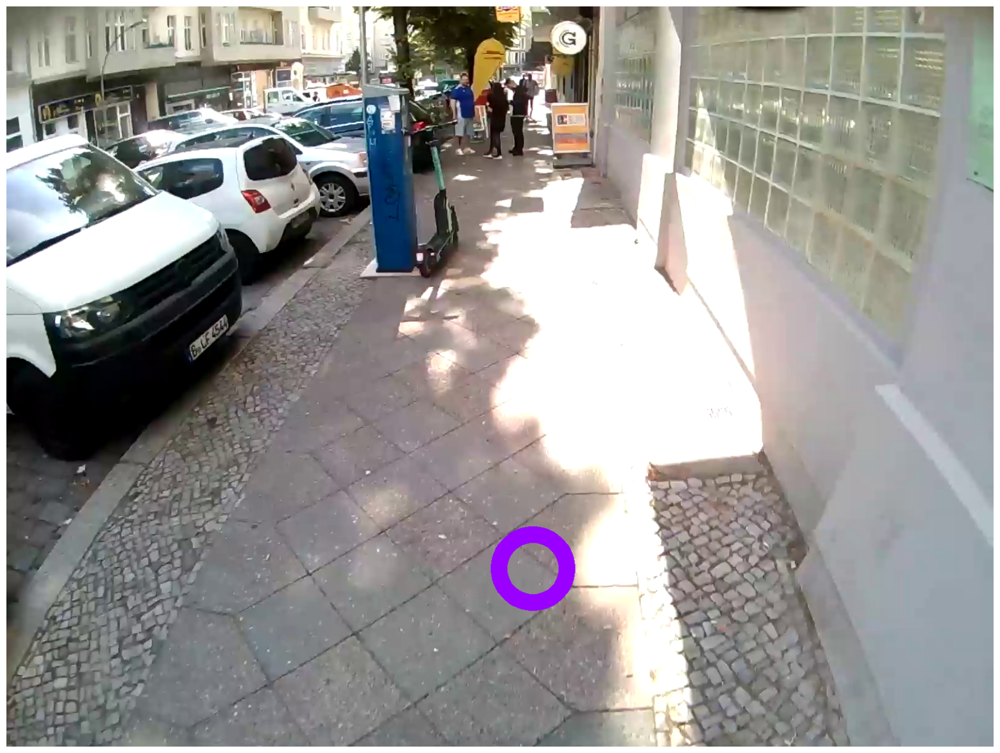

In [348]:
import cv2 as cv
image_gaze=cv.circle(neon_frame.copy(), (int(semantically_correct_gaze[0][0]),int(semantically_correct_gaze[0][1])), 55, (153,0,255), 25)
plt.figure(figsize=(25,15))
plt.imshow(image_gaze)
# plt.scatter(correspondences['keypoints0'][
# :,0],correspondences['keypoints0'][:,1],color='r')
plt.axis('off')
# cv.imwrite('/home/sof/Documents/Testing_videos/semantically_correct_gaze.png',cv.cvtColor(image_gaze,cv.COLOR_RGB2BGR))

(-0.5, 1919.5, 1079.5, -0.5)

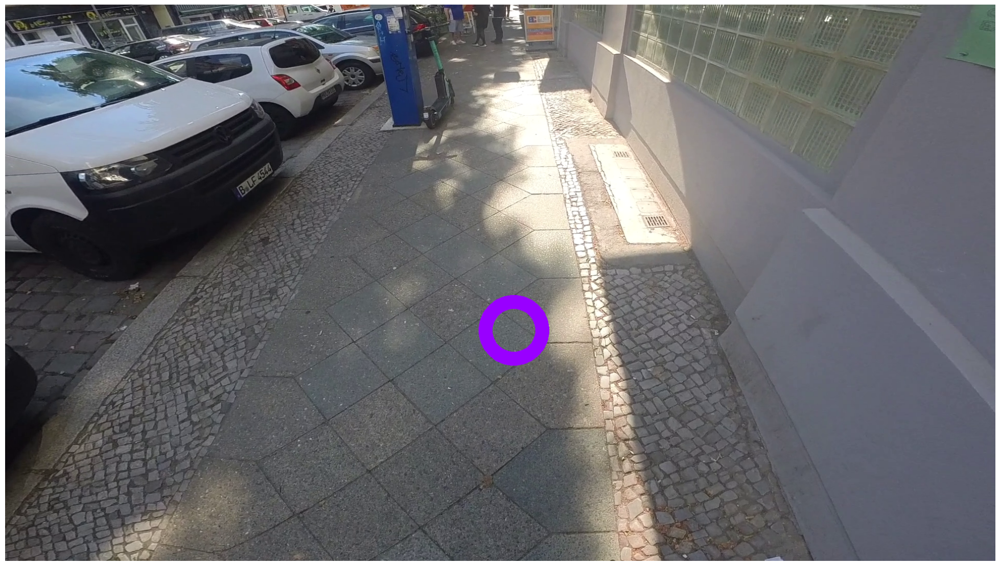

In [349]:
plt.figure(figsize=(25,15))
action_gaze=cv.circle(action_frame.copy(), np.int32(gaze_in_action_camera.reshape(-1)),55, (153,0,255), 25 )
plt.imshow(action_gaze)
# plt.scatter(correspondences['keypoints1'][:,0],correspondences['keypoints1'][:,1],color='r')
plt.axis('off')


Text(0.5, 1.0, 'Action')

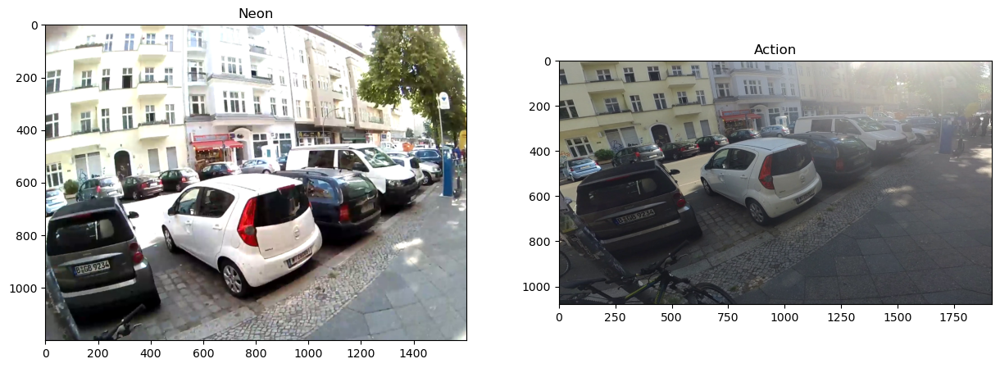

In [ ]:
neon_timestamp,neon_idx = mapper.neon_video.get_closest_timestamp(gaze_relative_timestamp)
action_timestamp,action_idx = mapper.action_video.get_closest_timestamp(neon_timestamp-mapper.action2neon_offset)
past_action_frame = mapper.action_video.get_frame_by_timestamp(mapper.action_video.timestamps[action_idx+10])
past_neon_frame = mapper.neon_video.get_frame_by_timestamp(mapper.neon_video.timestamps[neon_idx+10])
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
plt.imshow(past_neon_frame)
plt.title('Neon')
plt.subplot(1,2,2)
plt.imshow(past_action_frame)
plt.title('Action')

(-0.5, 1599.5, 1199.5, -0.5)

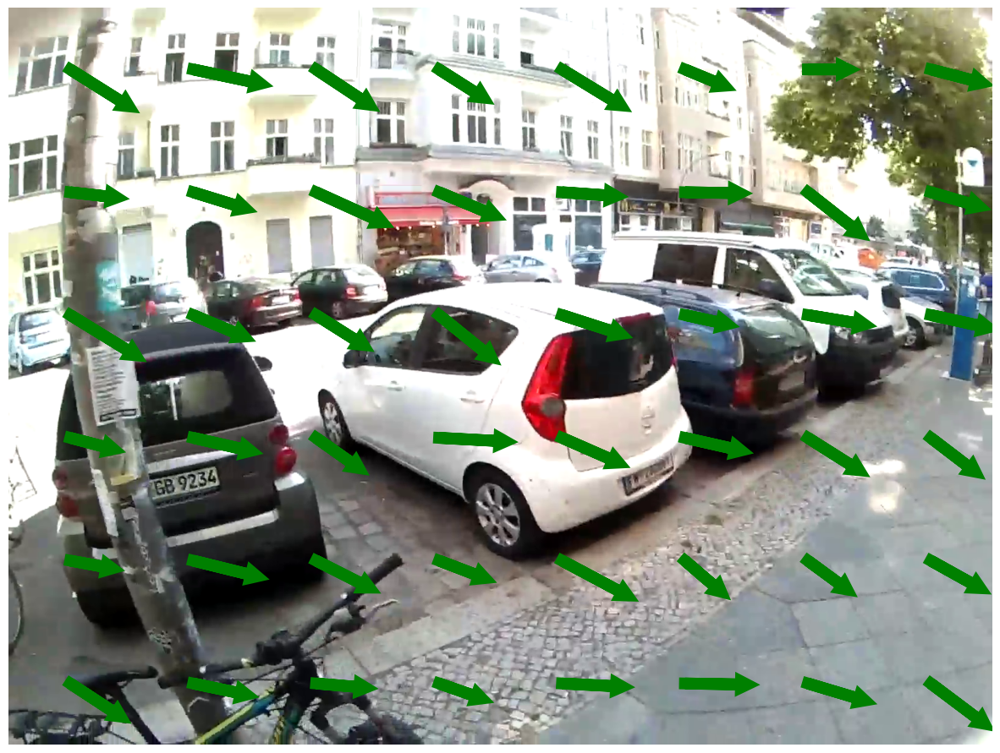

In [209]:
nx, ny = (neon_frame.shape[1]//200,neon_frame.shape[0]//200)
x = np.linspace(100, neon_frame.shape[1]-100, nx)
y = np.linspace(100, neon_frame.shape[0]-100, ny)
xv, yv = np.meshgrid(x, y)
xv, yv = np.meshgrid(x, y, indexing='xy')
p0=[]
for i in range(nx):
    for j in range(ny):
        p0.append([xv[j,i], yv[j,i]])


random_num=np.random.randint(low=15,high=25,size=len(p0))
p1 = []

for p in p0:
    angle=np.deg2rad(np.random.randint(0,45))
    p1.append(p+np.random.randint(low=65,high=105)*np.array([np.cos(angle),np.sin(np.deg2rad(np.random.randint(0,45)))]))
p0=np.array(p0)
p1=np.array(p1)
#plot quiver arrows from p0 to p1
plt.figure(figsize=(15,15))
plt.imshow(neon_frame)
for i in range(len(p0)):
    plt.arrow(p0[i,0],p0[i,1],p1[i,0]-p0[i,0],p1[i,1]-p0[i,1],head_width=10,head_length=10,fc='g',ec='g',linewidth=10)

plt.axis('off')




In [42]:
x_max, y_max

(1431, 1200)

True

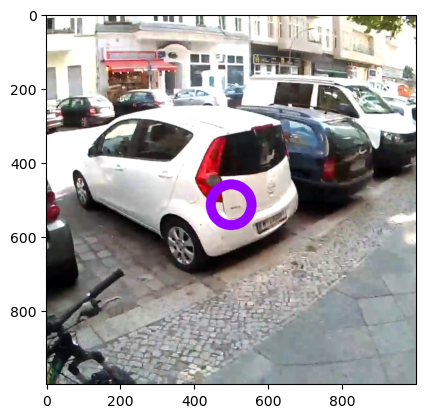

In [283]:
x_min, y_min = min(patch_corners[:,0]), min(patch_corners[:,1])
x_max, y_max = max(patch_corners[:,0]), max(patch_corners[:,1])
image_patch = image_gaze[y_min:y_max,x_min:x_max,:]
plt.imshow(image_patch)
cv.imwrite('/home/sof/Documents/Testing_videos/patch.png',cv.cvtColor(image_patch,cv.COLOR_RGB2BGR))

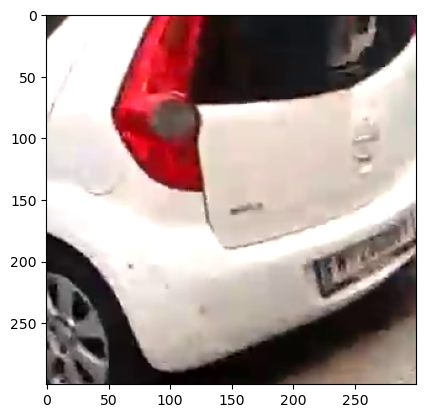

In [292]:
x_min, y_min = min(new_patch_corners[:,0]), min(new_patch_corners[:,1])
x_max, y_max = max(new_patch_corners[:,0]), max(new_patch_corners[:,1])
new_image_patch = neon_frame[y_min:y_max,x_min:x_max,:]
plt.imshow(new_image_patch)


To visualize the patch being transformed by the homgraphy:

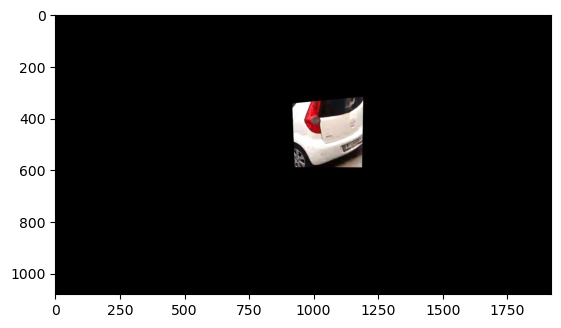

In [293]:
patch2scene_transformation=np.identity(3)
patch2scene_transformation[0,2]=new_patch_corners[0][0] #tx
patch2scene_transformation[1,2]=new_patch_corners[0][1] #ty 
u=cv.warpPerspective(new_image_patch,mapper.transformation@patch2scene_transformation,dsize=(action_frame.shape[1],action_frame.shape[0]))
plt.imshow(u)

(-0.5, 1919.5, 1079.5, -0.5)

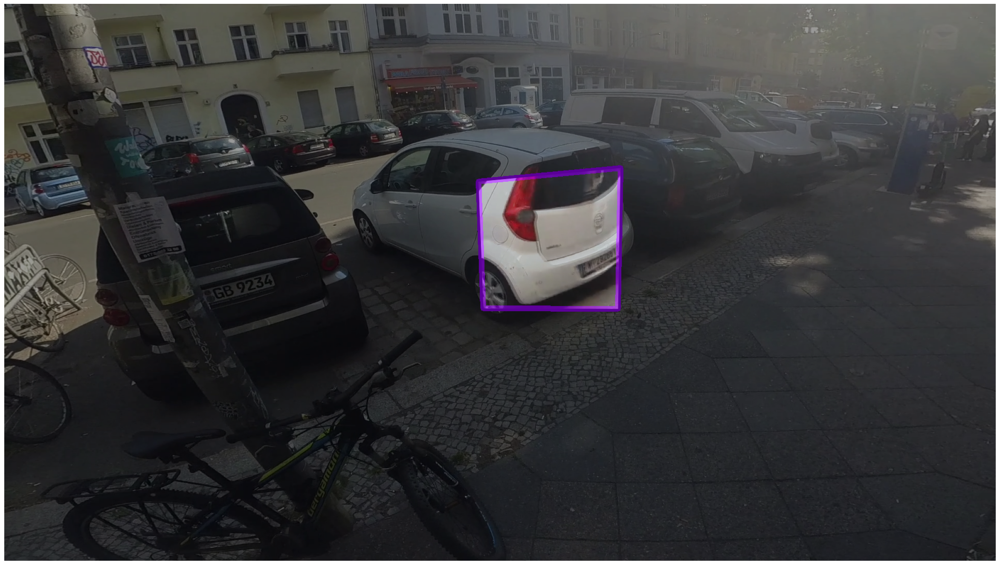

In [299]:
dst = cv.perspectiveTransform(np.float32(new_patch_corners).reshape(-1, 1, 2), mapper.transformation)
plt.figure(figsize=(30,30))
plt.imshow(cv.polylines(action_frame.copy(),[np.int32(dst)],isClosed=True,color=(153,0,255),thickness=10))
plt.imshow(u,alpha=0.4)
plt.axis('off')

(1.7080954960202844e+18, 1.7080954960802785e+18)

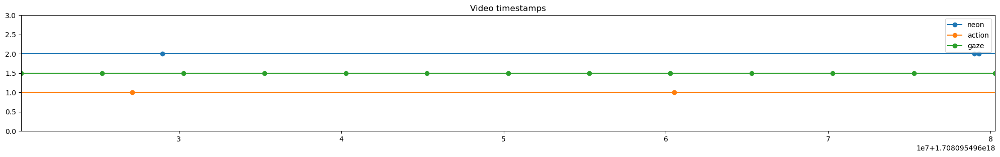

In [ ]:
neon_worldts = pd.read_csv(neon_timestamps)
action_worldts = pd.read_csv(action_timestamps)
gaze_ts= pd.read_csv(neon_timestamps.replace('world_timestamps.csv','gaze.csv'))
plt.figure(figsize=(25,3))
plt.title('Video timestamps')
plt.plot(neon_worldts['timestamp [ns]'].values,np.ones_like(neon_worldts['timestamp [ns]'].values)*2,'-o',label='neon')
plt.plot(action_worldts['timestamp [ns]'].values,np.ones_like(action_worldts['timestamp [ns]'].values),'-o',label='action')
plt.plot(gaze_ts['timestamp [ns]'].values,np.ones_like(gaze_ts['timestamp [ns]'].values)*1.5,'-o',label='gaze')
plt.legend()
plt.ylim(0,3)
# plt.xlim(neon_worldts['timestamp [ns]'].values[-30],neon_worldts['timestamp [ns]'].values[-1]+53222222)
#plt.xlim(neon_worldts['timestamp [ns]'].values[38],neon_worldts['timestamp [ns]'].values[52])
plt.xlim(gaze_ts['timestamp [ns]'].values[60],gaze_ts['timestamp [ns]'].values[72])

## Rethinking Gaze mapper logic: Trying to make it more efficient

### Re engineering map_gaze and map_one_gaze
1. No matter the gaze signal, once aligned the Neon Scene video frames are always going to be paired for image matching with the same Action camera frames.

2. Instead of looping thru all the gaze, we will loop thru the Neon frames that are way less. 
    - This way we are also just sequencially stepping thru the video.It would still use the first gaze timestamp to be mapped to determine from which Neon frame we need to begin the neon scene video stepping.
So given a Neon Frame and its timestamp, by looking at the timestamp before and after we can determine the time interval in which all gazes within are going to get moved to that Neon Frame:

$Lower Limit=ts -( (ts-ts_{before})/2)$

$Upper Limit= ts +( (ts_{after}-ts)/2)$

$Lower Limit <= gaze timestamps < Upper Limit$

3. This way the NeonVideoHandler is called only once per Neon frame to retrieve the image array and also the ActionVideoHandler. (move the get_frame_by timestamp call from map_one_gaze to map_gaze)

With the first gaze timestamp, find the Neon frame ts to which the gaze will be corrected to. From there we can stablish all Neon-Action frame correspondences that will be used

In [ ]:
after_posiciones=np.searchsorted(mapper.action_ts['timestamp [ns]'].values,mapper.neon_ts['timestamp [ns]'].values)
before_posiciones=after_posiciones-1
before_posiciones[before_posiciones==-1]=0
after_posiciones[after_posiciones==len(mapper.action_ts['timestamp [ns]'].values)]=len(mapper.action_ts['timestamp [ns]'].values)-1


after_diff=mapper.action_ts["timestamp [ns]"].values[after_posiciones]-mapper.neon_ts["timestamp [ns]"].values
before_diff=mapper.neon_ts["timestamp [ns]"].values-mapper.action_ts["timestamp [ns]"].values[before_posiciones]

stacked_diff=np.array([after_diff,before_diff])
stacked_posiciones=np.array([after_posiciones,before_posiciones])
selected_indexes=np.argmin(np.abs(stacked_diff),axis=0,keepdims=True)
ind=np.take_along_axis(stacked_posiciones,selected_indexes,axis=0)
ind.shape=-1

In [17]:
def get_corresponding_timestamps_index(timestamps_1, timestamps_2):
    """For each timestamp in timestamps_2, finds the index of the closest timestamp in timestamps_1
    Args:
        timestamps_1 (_type_): 1-DIM array with timestamps
        timestamps_2 (_type_): 1-DIM array with timestamps to be compared with timestamps_1

    Returns:
        ndarray: 1-DIM array with the indexes of the timestamps_1 that are closest to the timestamps_2. Same length as timestamps_2
    """
    after_posiciones=np.searchsorted(timestamps_1,timestamps_2)
    before_posiciones=after_posiciones-1
    before_posiciones[before_posiciones==-1]=0
    after_posiciones[after_posiciones==len(timestamps_1)]=len(timestamps_1)-1


    after_diff=timestamps_1[after_posiciones]-timestamps_2
    before_diff=timestamps_2-timestamps_1[before_posiciones]

    stacked_diff=np.array([after_diff,before_diff])
    stacked_posiciones=np.array([after_posiciones,before_posiciones])
    selected_indexes=np.argmin(np.abs(stacked_diff),axis=0,keepdims=True)
    indexes=np.take_along_axis(stacked_posiciones,selected_indexes,axis=0)
    indexes.shape=-1
    return indexes

Obtaining the indexes of the corresponding action video frames for each neon frame. Same length as Neon videotimestamps

In [19]:
corresponding_action_index=get_corresponding_timestamps_index(mapper2.action_ts['timestamp [ns]'].values,mapper2.neon_ts['timestamp [ns]'].values)

UTC timestamps and the difference in seconds

In [26]:
n=1262
print(f'Action:{mapper2.action_ts["timestamp [ns]"].values[corresponding_action_index[n]]}')
print(f'Neon:{mapper2.neon_ts["timestamp [ns]"].values[n]}')
print((mapper2.action_ts["timestamp [ns]"].values[corresponding_action_index[n]]-mapper2.neon_ts["timestamp [ns]"].values[n])/1e9)
print(f'Action relative:{mapper2.action_video.timestamps[corresponding_action_index[n]]}')
print(f'Neon relative:{mapper2.neon_video.timestamps[n]}')

Action:1716475698716898304
Neon:1716475698721666666
-0.004768362
Action relative:40.94089889526367
Neon relative:42.961666107177734


(1.7164756985716664e+18, 1.7164756987716664e+18)

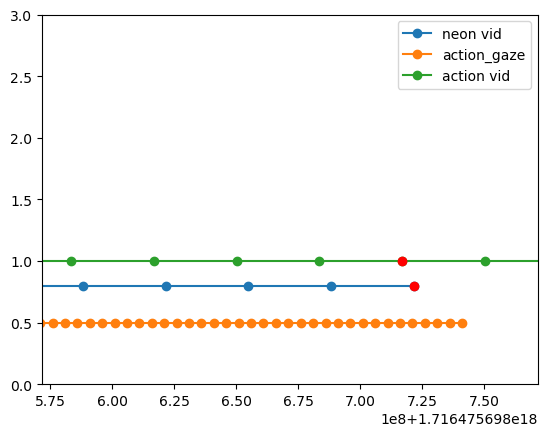

In [30]:
plt.plot(mapper2.neon_ts['timestamp [ns]'].values,np.ones_like(mapper2.neon_ts['timestamp [ns]'].values)*.8,'-o',label='neon vid')
plt.plot(mapper2.action_gaze['timestamp [ns]'].values,np.ones_like(mapper2.action_gaze['timestamp [ns]'].values)*.5,'-o',label='action_gaze')
plt.plot(mapper2.action_ts['timestamp [ns]'].values,np.ones_like(mapper2.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper2.neon_ts['timestamp [ns]'].values[n],0.8,color='r',zorder=2)
plt.scatter(mapper2.action_ts['timestamp [ns]'].values[corresponding_action_index[n]],1,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper2.neon_ts['timestamp [ns]'].values[n]-.15*1e9,mapper2.neon_ts['timestamp [ns]'].values[n]+.05*1e9)

It works both ways: now obtaining the corresponding neon frames for each action frame

In [ ]:
corresponding_neon_index=get_corresponding_timestamps_index(mapper.neon_ts['timestamp [ns]'].values,mapper.action_ts['timestamp [ns]'].values)

In [ ]:
n=0
print(f'Action:{mapper.action_ts["timestamp [ns]"].values[n]}')
print(f'Neon:{mapper.neon_ts["timestamp [ns]"].values[corresponding_neon_index[n]]}')
print((mapper.action_ts["timestamp [ns]"].values[n]-mapper.neon_ts["timestamp [ns]"].values[corresponding_neon_index[n]])/1e9)
print(f'Action relative:{mapper.action_video.timestamps[n]}')
print(f'Neon relative:{mapper.neon_video.timestamps[corresponding_neon_index[n]]}')

Action:1716475657776000128
Neon:1716475657760000000
0.016000128
Action relative:0.0
Neon relative:2.0


(1.7164756586440333e+18, 1.7164756596440333e+18)

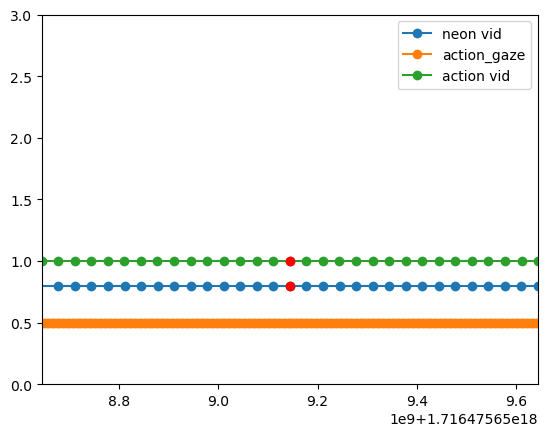

In [ ]:
plt.plot(mapper.neon_ts['timestamp [ns]'].values,np.ones_like(mapper.neon_ts['timestamp [ns]'].values)*.8,'-o',label='neon vid')
plt.plot(mapper.action_gaze['timestamp [ns]'].values,np.ones_like(mapper.action_gaze['timestamp [ns]'].values)*.5,'-o',label='action_gaze')
plt.plot(mapper.action_ts['timestamp [ns]'].values,np.ones_like(mapper.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper.neon_ts['timestamp [ns]'].values[corresponding_neon_index[n]],0.8,color='r',zorder=2)
plt.scatter(mapper.action_ts['timestamp [ns]'].values[n],1,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper.action_ts['timestamp [ns]'].values[n]-.5*1e9,mapper.action_ts['timestamp [ns]'].values[n]+.5*1e9)

But since gaze is being moved to the closest Neon Frame what we need is the corresponding action frame indexes for every neon frame :)

In [ ]:
gaze_ts=mapper.action_gaze['timestamp [ns]'].values
neon_start_frame=mapper.neon_video.get_closest_timestamp((gaze_ts[0]-mapper.neon_ts['timestamp [ns]'].values[0])/1e9)[1]
corresponding_action_index=get_corresponding_timestamps_index(mapper.action_ts['timestamp [ns]'].values,mapper.neon_ts['timestamp [ns]'].values)
for i,neon_ts in enumerate(mapper.neon_ts['timestamp [ns]'].values[neon_start_frame:],start=neon_start_frame):
    lower_bound = neon_ts-(neon_ts-mapper.neon_ts['timestamp [ns]'].values[i-1])/2 if i>0 else 0
    upper_bound = neon_ts+(mapper.neon_ts['timestamp [ns]'].values[i+1]-neon_ts)/2 if i<len(mapper.neon_ts['timestamp [ns]'].values)-1 else np.inf
    
    gazes_for_this_frame = mapper.action_gaze.loc[mapper.action_gaze['timestamp [ns]'].between(lower_bound,upper_bound,inclusive='left')]

    print(f'({i}) Neon ts: {neon_ts}, lower bound: {lower_bound}, upper bound: {upper_bound}')
    print(f'Action ts:({corresponding_action_index[i]}) {mapper.action_ts["timestamp [ns]"].values[corresponding_action_index[i]]} (difference:{(neon_ts-mapper.action_ts["timestamp [ns]"].values[corresponding_action_index[i]])/1e9})')
    print(f'Gazes for this frame: {len(gazes_for_this_frame)}')

    neon_frame = mapper.neon_video.get_frame_by_timestamp(mapper.neon_video.timestamps[i])
    action_frame = mapper.action_video.get_frame_by_timestamp(mapper.action_video.timestamps[corresponding_action_index[i]])

    break

(41) Neon ts: 1716475657809999999, lower bound: 1.716475657785e+18, upper bound: 1.7164756578349998e+18
Action ts:(1) 1716475657809366784 (difference:0.000633215)
Gazes for this frame: 4


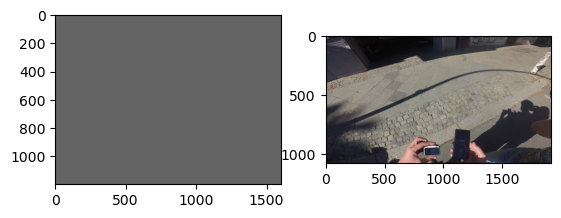

In [ ]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(neon_frame)
plt.subplot(1,2,2)
plt.imshow(action_frame)

(1.7164756577099999e+18, 1.7164756579099999e+18)

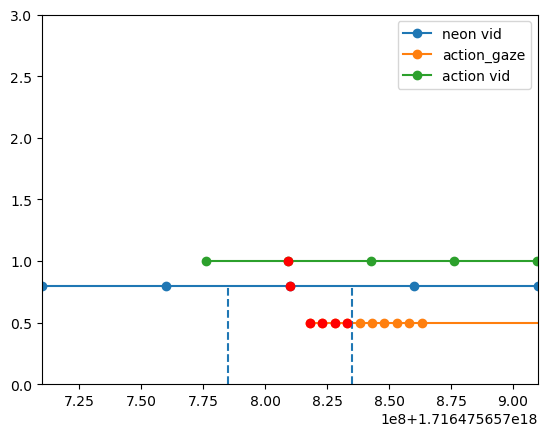

In [ ]:
plt.plot(mapper.neon_ts['timestamp [ns]'].values,np.ones_like(mapper.neon_ts['timestamp [ns]'].values)*.8,'-o',label='neon vid')
plt.plot(mapper.action_gaze['timestamp [ns]'].values,np.ones_like(mapper.action_gaze['timestamp [ns]'].values)*.5,'-o',label='action_gaze')
plt.plot(mapper.action_ts['timestamp [ns]'].values,np.ones_like(mapper.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper.neon_ts['timestamp [ns]'].values[i],0.8,color='r',zorder=2)
plt.scatter(mapper.action_ts['timestamp [ns]'].values[corresponding_action_index[i]],1,color='r',zorder=2)
plt.vlines([lower_bound,upper_bound],0,0.8,linestyles='dashed')
plt.scatter(gazes_for_this_frame['timestamp [ns]'].values,np.ones_like(gazes_for_this_frame['timestamp [ns]'].values)*.5,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper.neon_ts['timestamp [ns]'].values[i]-.1*1e9,mapper.neon_ts['timestamp [ns]'].values[i]+.1*1e9)

(1949999872.0, 2149999872.0)

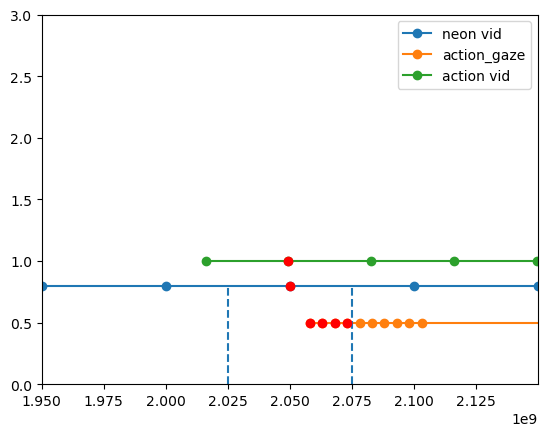

In [ ]:
f_neon=mapper.neon_ts['timestamp [ns]'].values[0]
plt.plot(mapper.neon_ts['timestamp [ns]'].values-f_neon,np.ones_like(mapper.neon_ts['timestamp [ns]'].values)*.8,'-o',label='neon vid')
plt.plot(mapper.action_gaze['timestamp [ns]'].values-f_neon,np.ones_like(mapper.action_gaze['timestamp [ns]'].values)*.5,'-o',label='action_gaze')
plt.plot(mapper.action_ts['timestamp [ns]'].values-f_neon,np.ones_like(mapper.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper.neon_ts['timestamp [ns]'].values[i]-f_neon,0.8,color='r',zorder=2)
plt.scatter(mapper.action_ts['timestamp [ns]'].values[corresponding_action_index[i]]-f_neon,1,color='r',zorder=2)
plt.vlines([lower_bound-f_neon,upper_bound-f_neon],0,0.8,linestyles='dashed')
plt.scatter(gazes_for_this_frame['timestamp [ns]'].values-f_neon,np.ones_like(gazes_for_this_frame['timestamp [ns]'].values)*.5,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper.neon_ts['timestamp [ns]'].values[i]-.1*1e9-f_neon,mapper.neon_ts['timestamp [ns]'].values[i]+.1*1e9-f_neon)

(-66000128.0, 133999872.0)

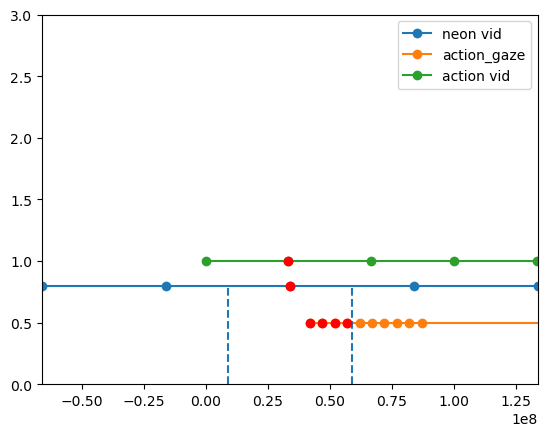

In [ ]:
f_neon=mapper.action_ts['timestamp [ns]'].values[0]
plt.plot(mapper.neon_ts['timestamp [ns]'].values-f_neon,np.ones_like(mapper.neon_ts['timestamp [ns]'].values)*.8,'-o',label='neon vid')
plt.plot(mapper.action_gaze['timestamp [ns]'].values-f_neon,np.ones_like(mapper.action_gaze['timestamp [ns]'].values)*.5,'-o',label='action_gaze')
plt.plot(mapper.action_ts['timestamp [ns]'].values-f_neon,np.ones_like(mapper.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper.neon_ts['timestamp [ns]'].values[i]-f_neon,0.8,color='r',zorder=2)
plt.scatter(mapper.action_ts['timestamp [ns]'].values[corresponding_action_index[i]]-f_neon,1,color='r',zorder=2)
plt.vlines([lower_bound-f_neon,upper_bound-f_neon],0,0.8,linestyles='dashed')
plt.scatter(gazes_for_this_frame['timestamp [ns]'].values-f_neon,np.ones_like(gazes_for_this_frame['timestamp [ns]'].values)*.5,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper.neon_ts['timestamp [ns]'].values[i]-.1*1e9-f_neon,mapper.neon_ts['timestamp [ns]'].values[i]+.1*1e9-f_neon)

In [ ]:
'/users/sof/action_map_experiments/new_mapper/second_video_2/mapped_gaze/loftr/action_gaze_lk.csv'

In [ ]:
mapper2 = ActionCameraGazeMapper2(neon_gaze_csv=neon_gaze_csv,
        neon_video_dir=neon_vid_path,
        action_video_dir=action_vid_path,
        neon_timestamps=neon_timestamps,
        action_timestamps=action_timestamps,
        image_matcher=image_matcher['choice'],
        image_matcher_parameters=image_matcher['parameters'],
        neon_opticflow_csv=neon_of_csv,
        action_opticflow_csv=action_of_csv,
        patch_size=1000)

### Re engineering with thresholds

In [ ]:
corresponding_action_index=get_corresponding_timestamps_index(mapper2.action_ts['timestamp [ns]'].values,mapper2.action_gaze['timestamp [ns]'].values)
corresponding_neon_index= get_corresponding_timestamps_index(mapper2.neon_ts['timestamp [ns]'].values,mapper2.action_gaze['timestamp [ns]'].values)

Action:223
Neon:257


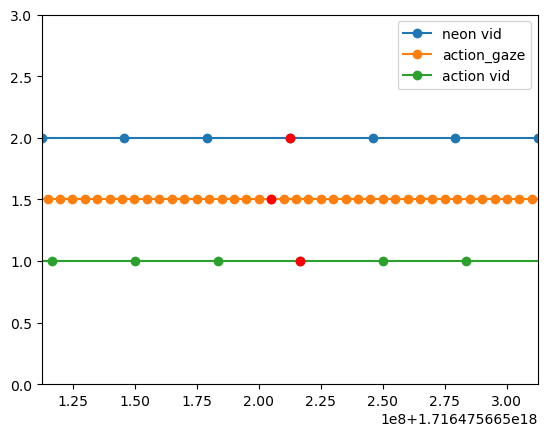

In [ ]:
n=1457
plt.plot(mapper2.neon_ts['timestamp [ns]'].values,np.ones_like(mapper2.neon_ts['timestamp [ns]'].values)*2,'-o',label='neon vid')
plt.plot(mapper2.action_gaze['timestamp [ns]'].values,np.ones_like(mapper2.action_gaze['timestamp [ns]'].values)*1.5,'-o',label='action_gaze')
plt.plot(mapper2.action_ts['timestamp [ns]'].values,np.ones_like(mapper2.action_ts['timestamp [ns]'].values),'-o',label='action vid')
plt.scatter(mapper2.neon_ts['timestamp [ns]'].values[corresponding_neon_index[n]],2,color='r',zorder=2)
plt.scatter(mapper2.action_ts['timestamp [ns]'].values[corresponding_action_index[n]],1,color='r',zorder=2)
plt.scatter(mapper2.action_gaze['timestamp [ns]'].values[n],1.5,color='r',zorder=2)
plt.ylim(0,3)
plt.legend()
plt.xlim(mapper2.neon_ts['timestamp [ns]'].values[corresponding_neon_index[n]]-.1*1e9,mapper2.neon_ts['timestamp [ns]'].values[corresponding_neon_index[n]]+.1*1e9)
print(f'Action:{corresponding_action_index[n]}')
print(f'Neon:{corresponding_neon_index[n]}')

In [ ]:
corresponding_action_index=get_corresponding_timestamps_index(mapper2.action_ts['timestamp [ns]'].values,mapper2.action_gaze['timestamp [ns]'].values)
corresponding_neon_index= get_corresponding_timestamps_index(mapper2.neon_ts['timestamp [ns]'].values,mapper2.action_gaze['timestamp [ns]'].values)

dopticf_threshold=0.1 
dgaze_thrshld=100 # it has to move 100 pixels
refresh_rate=30
gazes_since_refresh=0

for i, gaze_ts in enumerate(mapper2.action_gaze['timestamp [ns]'].values[1456:],start=1456):
    gaze_neon = mapper2.neon_gaze.loc[mapper2.neon_gaze["timestamp [ns]"] == gaze_ts,["gaze x [px]", "gaze y [px]"]].values.reshape(1, 2)
    
    gaze_relative_ts = (gaze_ts - mapper2.neon_ts["timestamp [ns]"].values[0]) / 1e9
    neon_relative_ts = mapper2.neon_video.timestamps[corresponding_neon_index[i]]
    action_relative_ts = mapper2.action_video.timestamps[corresponding_action_index[i]]
    
    if i==1456 or gazes_since_refresh==refresh_rate:
        print('first gaze or refreshing transformation')
        action_frame = mapper2.action_video.get_frame_by_timestamp(action_relative_ts)
        neon_frame = mapper2.neon_video.get_frame_by_timestamp(neon_relative_ts)
        
        if mapper2._gaze_between_video_frames(gaze_ts):
            semantic_gaze = mapper2._move_point_to_video_timestamp(gaze_neon,gaze_relative_ts, neon_relative_ts, mapper2.neon_opticflow)
            gaze_action_camera,corr = mapper2._map_one_gaze(semantic_gaze, neon_frame, action_frame)
            gaze_action_camera = mapper2._move_point_to_arbitrary_timestamp(gaze_action_camera,action_relative_ts,mapper2.action_opticflow,gaze_relative_ts-mapper2.action2neon_offset)
        else:
            gaze_action_camera,corr = mapper2._map_one_gaze(gaze_neon, neon_frame, action_frame)
        print(f'correspondences: {len(corr["keypoints0"])}')

        gazes_since_refresh=0
        acc_action_opticflow=0
        acc_neon_opticflow=0

    else:
        #check if the closest frames to the gaze timestamp have changed
        if corresponding_action_index[i] != corresponding_action_index[i-1]:
            print(f'Action frame changed')
            print(f'{mapper2.action_video.timestamps[corresponding_action_index[i]]}({action_relative_ts})')
            print(mapper2.action_opticflow.loc[
                        mapper2.action_opticflow["end"] == action_relative_ts, ["dx", "dy"]
                    ].values)
            
            action_frame = mapper2.action_video.get_frame_by_timestamp(corresponding_action_index[i])
            acc_action_opticflow += mapper2.action_opticflow.loc[
                        mapper2.action_opticflow["end"] == action_relative_ts, ["dx", "dy"]
                    ].values
            break
        if corresponding_neon_index[i] != corresponding_neon_index[i-1]:
            print(f'Neon frame changed')
            break
            neon_frame = mapper2.neon_video.get_frame_by_timestamp(corresponding_neon_index[i])
            acc_neon_opticflow += mapper2.neon_opticflow[["dx","dy"]]
        
        #check the gaze displacement
        if np.linalg.norm(gaze_neon-last_gaze_coords)>dgaze_thrshld:
            print(f'Gaze displacement: {np.linalg.norm(gaze_neon-last_gaze_coords)}')
            break
            if mapper._gaze_between_video_frames(gaze_ts):
                semantic_gaze = mapper2._move_point_to_video_timestamp(gaze_neon,gaze_relative_ts, neon_relative_ts, mapper.neon_opticflow)
                gaze_action_camera,corr = mapper2._map_one_gaze(semantic_gaze, neon_frame, action_frame)
                gaze_action_camera = mapper2._move_point_to_arbitrary_timestamp(gaze_action_camera,action_relative_ts,mapper.action_opticflow,gaze_ts)
            else:
                gaze_action_camera = mapper2._map_one_gaze(gaze_neon, neon_frame, action_frame)
            gazes_since_refresh=0
            acc_action_opticflow=0
            acc_neon_opticflow=0

        elif acc_action_opticflow>dopticf_threshold or acc_neon_opticflow>dopticf_threshold:
            print(f'Optic flow displacement: {acc_action_opticflow.norm()}')
            break
            if mapper._gaze_between_video_frames(gaze_ts):
                semantic_gaze = mapper2._move_point_to_video_timestamp(gaze_neon,gaze_relative_ts, neon_relative_ts, mapper.neon_opticflow)
                gaze_action_camera,corr = mapper2._map_one_gaze(semantic_gaze, neon_frame, action_frame)
                gaze_action_camera = mapper2._move_point_to_arbitrary_timestamp(gaze_action_camera,action_relative_ts,mapper.action_opticflow,gaze_ts)
            else:
                gaze_action_camera = mapper2._map_one_gaze(gaze_neon, neon_frame, action_frame)
            #refresh the correspondences
            gazes_since_refresh=0
            acc_action_opticflow=0
            acc_neon_opticflow=0
        else: #if the gaze has not moved enough and the optic flow has not changed that much
            print(f'Adjusting correspondences with optic flow displacement')
            continue
            #check if _move_point_to_video_timestamp would work with this so we can move the correspondences. 
            if mapper._gaze_between_video_frames(gaze_ts):
                semantic_gaze = mapper2._move_point_to_video_timestamp(gaze_neon,gaze_relative_ts, neon_relative_ts, mapper.neon_opticflow)
                filt_correspondences, new_patch_corners = mapper2._filter_correspondences(corr.copy(),semantic_gaze, neon_frame.shape)
                print(f'Number of correspondences: {len(filt_correspondences["keypoints0"])} at {abs(new_patch_corners[0,0]-new_patch_corners[2,0])} patch size')
                gaze_in_action_camera = mapper2._transform_point(filt_correspondences, semantic_gaze)
            else:
                filt_correspondences, new_patch_corners = mapper2._filter_correspondences(corr.copy(),gaze_neon, neon_frame.shape)
                print(f'Number of correspondences: {len(filt_correspondences["keypoints0"])} at {abs(new_patch_corners[0,0]-new_patch_corners[2,0])} patch size')
                gaze_in_action_camera = mapper2._transform_point(filt_correspondences, gaze_neon)


    print(f"({i}) Gaze ({gaze_neon}) at {gaze_relative_ts} mapped to {gaze_action_camera}")
    #keeping memory
    last_gaze_coords = gaze_neon
    gazes_since_refresh+=1
#(1456) Gaze ([[937.686 717.62 ]]) at 9.439969454 mapped to [[1059.8395   466.77316]]

first gaze or refreshing transformation
Number of correspondences: 245 at 300 patch size
correspondences: 2344
(1456) Gaze ([[937.686 717.62 ]]) at 9.439969454 mapped to [[1059.8395   466.77316]]
Action frame changed
7.44076681137085(7.44076681137085)
[[-13.385843  -8.052637]]


- Idea una flag que indique que _move_point_to_video_timestamp, _map_one_gaze y _move_point_to_arbitrary_timestamp tienen que hacerse
- correspondences will have to be an attribute or some output
- probably will have to create a new method that calls 

In [ ]:
acc_action_opticflow+=np.array([[1,1]])
np.linalg.norm(acc_action_opticflow)

12.894644

In [ ]:
mapper2.action_opticflow.iloc[220:225]

,start,end,dx,dy,angle
220,7.340667,7.374033,-13.228379,-6.359514,-2.693465
221,7.374033,7.407400,-13.174871,-7.929516,-2.599802
222,7.407400,7.440767,-13.385843,-8.052637,-2.600013
223,7.440767,7.474133,-13.379966,-5.269026,-2.766443
224,7.474133,7.507500,-13.104487,-1.004478,-3.065091


In [ ]:
mapper2._move_point_to_video_timestamp(pr,1.918,mapper2.action_video.timestamps[58],mapper2.action_opticflow)

array([[-8.43214512,  0.78169906],
       [-6.43214512,  3.78169906],
       [-1.43214512,  4.78169906]])

In [ ]:
mapper2.action_video.timestamps[58]-1.918

0.017266613960266186

In [5]:
from gaze_mapper import RulesBasedGazeMapper
mapper3=RulesBasedGazeMapper(neon_gaze_csv=neon_gaze_csv,
        neon_video_dir=neon_vid_path,
        action_video_dir=action_vid_path,
        neon_timestamps=neon_timestamps,
        action_timestamps=action_timestamps,
        image_matcher=image_matcher['choice'],
        image_matcher_parameters=image_matcher['parameters'],
        neon_opticflow_csv=neon_of_csv,
        action_opticflow_csv=action_of_csv,
        patch_size=1000)

In [6]:
mapper3.map_gaze()

Neon frame is all gray


(0) Transforming gaze [[837.985 915.875]] at 2.058091454
Neon frame is all gray . 


Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


(0) Gaze mapped to [[838.83108918 916.4507913 ]]
(1) Transforming gaze [[837.985 915.875]] at 2.063091454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(1) Gaze mapped to [[839.31597291 916.78077054]]
(2) Transforming gaze [[837.985 915.875]] at 2.068091454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(2) Gaze mapped to [[836.56506597 914.90868855]]
(3) Transforming gaze [[837.985 915.875]] at 2.073091454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(3) Gaze mapped to [[837.04994981 915.23866785]]
(4) Transforming gaze [[837.985 915.875]] at 2.078091454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(4) Gaze mapped to [[837.53483351 915.568647  ]]
(5) Transforming gaze [[837.985 915.875]] at 2.083091454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(5) Gaze mapped to [[838.02314527 915.89736442]]
(6) Transforming gaze [[83

Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(10) Gaze mapped to [[839.82600902 928.18375764]]
(11) Transforming gaze [[840.802 935.602]] at 2.198216454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(11) Gaze mapped to [[842.30875619 936.66539848]]
(12) Transforming gaze [[840.996 958.852]] at 2.203216454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(12) Gaze mapped to [[839.72425575 957.95446205]]
(13) Transforming gaze [[844.935 980.994]] at 2.208216454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(13) Gaze mapped to [[844.15300292 980.44210283]]
(14) Transforming gaze [[848.849 990.418]] at 2.213216454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(14) Gaze mapped to [[848.55675017 990.21174367]]
(15) Transforming gaze [[ 824.516 1037.763]] at 2.218216454
Neon frame is all gray . 
(15) Gaze mapped to [[ 824.71150189 1

Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


Neon frame is all gray . 
(28) Gaze mapped to [[ 912.34974127 1243.61420333]]
(29) Transforming gaze [[ 919.77  1235.319]] at 2.288341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(29) Gaze mapped to [[ 920.24648677 1235.60694846]]
(30) Transforming gaze [[ 896.613 1248.852]] at 2.293345454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(30) Gaze mapped to [[ 897.53037765 1249.40638578]]
(31) Transforming gaze [[ 898.585 1227.473]] at 2.298341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(31) Gaze mapped to [[ 899.94256373 1228.29339714]]
(32) Transforming gaze [[ 900.616 1227.436]] at 2.303341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(32) Gaze mapped to [[ 899.47424084 1226.74601699]]
(33) Transforming gaze [[ 885.898 1205.369]] at 2.308341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(33) Gaze mapped to

Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(46) Gaze mapped to [[ 890.83895031 1249.29869841]]
(47) Transforming gaze [[ 880.032 1244.197]] at 2.378341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(47) Gaze mapped to [[ 879.5517379 1243.8511988]]
(48) Transforming gaze [[ 874.705 1250.803]] at 2.383341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(48) Gaze mapped to [[ 874.74467614 1250.82833496]]
(49) Transforming gaze [[ 880.443 1242.667]] at 2.388351454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(49) Gaze mapped to [[ 881.12807135 1243.10444817]]
(50) Transforming gaze [[ 874.982 1244.66 ]] at 2.393341454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(50) Gaze mapped to [[ 876.30989016 1245.50791625]]
(51) Transforming gaze [[ 879.61  1232.413]] at 2.398341454
-Mapping gaze with the new correspondences (in 

Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


(64) Transforming gaze [[ 669.426 1066.717]] at 2.463466454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(64) Gaze mapped to [[ 671.36155152 1067.74628233]]
(65) Transforming gaze [[ 682.443 1007.507]] at 2.468466454
Neon frame is all gray . 
(65) Gaze mapped to [[ 680.3707761  1006.40503851]]
(66) Transforming gaze [[722.697 963.815]] at 2.473466454
Neon frame is all gray . 
(66) Gaze mapped to [[721.33119926 963.08869821]]
(67) Transforming gaze [[771.921 948.556]] at 2.478466454
Neon frame is all gray . 
(67) Gaze mapped to [[771.26162231 948.20535794]]
(68) Transforming gaze [[789.755 947.513]] at 2.483471454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(68) Gaze mapped to [[789.8034351  947.53452818]]
(69) Transforming gaze [[775.892 972.894]] at 2.488466454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(69) Gaze mapped to [[776.65625052 973.23369015]]
(70) Transforming gaze [[786.

Neon frame is all gray
Neon frame is all gray
Neon frame is all gray
Neon frame is all gray


Neon frame is all gray . 
(80) Gaze mapped to [[758.25828413 860.08874042]]
(81) Transforming gaze [[768.138 859.499]] at 2.548591454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(81) Gaze mapped to [[767.96307879 859.43594669]]
(82) Transforming gaze [[787.228 875.847]] at 2.553591454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(82) Gaze mapped to [[787.64033799 876.00214374]]
(83) Transforming gaze [[814.39  861.928]] at 2.558591454
-Mapping gaze with the new correspondences (in else)
Neon frame is all gray . 
(83) Gaze mapped to [[815.355859   862.29140815]]
(84) Transforming gaze [[827.629 853.611]] at 2.563591454
-Mapping gaze with the new correspondences (in else)
(84) Gaze mapped to [[962.57916 585.6053 ]]
(85) Transforming gaze [[826.624 894.433]] at 2.568596454
Moving keypoints1 to 0.5672333240509033
-Mapping gaze with the existing correspondences (2368)
(85) Gaze mapped to [[964.03784 621.9565 ]]
(86) Transf

KeyboardInterrupt: 

In [9]:
last_gaze = np.array([[0, 0]])
last_gaze.shape


(1, 2)

In [6]:
for i, gaze_ts in enumerate(mapper3.action_gaze["timestamp [ns]"].values):

    gaze_neon = mapper3.neon_gaze.loc[
        mapper3.neon_gaze["timestamp [ns]"] == gaze_ts,
        ["gaze x [px]", "gaze y [px]"],
    ].values.reshape(1, 2)
    gaze_relative_ts = (
        gaze_ts - mapper3.neon_ts["timestamp [ns]"].values[0]
    ) / 1e9
    neon_relative_ts = mapper3.neon_video.timestamps[
        mapper3.corresponding_neon_idx[i]
    ]
    action_relative_ts = mapper3.action_video.timestamps[
        mapper3.corresponding_action_idx[i]
    ]
    print(gaze_relative_ts,neon_relative_ts,action_relative_ts)
    gaze_relative_ts,neon_relative_ts,action_relative_ts = mapper3._obtain_relative_ts(gaze_ts,i)
    print(gaze_relative_ts,neon_relative_ts,action_relative_ts)
    if i==10:
        break

2.058091454 2.05 0.033366665
2.058091454 2.05 0.033366665
2.063091454 2.05 0.033366665
2.063091454 2.05 0.033366665
2.068091454 2.05 0.06673333
2.068091454 2.05 0.06673333
2.073091454 2.05 0.06673333
2.073091454 2.05 0.06673333
2.078091454 2.1 0.06673333
2.078091454 2.1 0.06673333
2.083091454 2.1 0.06673333
2.083091454 2.1 0.06673333
2.088091454 2.1 0.06673333
2.088091454 2.1 0.06673333
2.093091454 2.1 0.06673333
2.093091454 2.1 0.06673333
2.098091454 2.1 0.06673333
2.098091454 2.1 0.06673333
2.103091454 2.1 0.1001
2.103091454 2.1 0.1001
2.193216454 2.2 0.16683333
2.193216454 2.2 0.16683333


## Parsing log file

/cluster/anaconda3/envs/sof_gazemapping/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)
/cluster/anaconda3/envs/sof_gazemapping/lib/python3.11/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


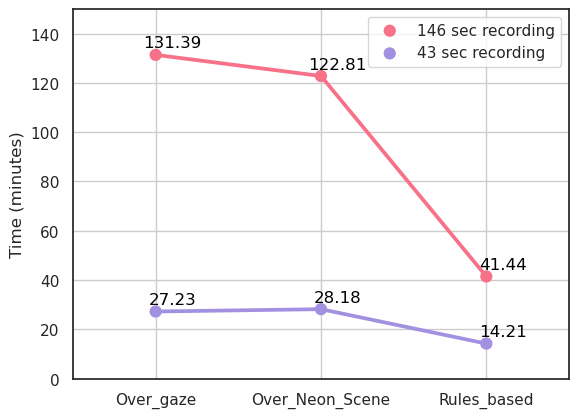

In [4]:
import seaborn as sns

sns.set_theme(style="white", palette="husl")
times= {'Over_gaze':[(1718642468.991183-1718634585.863508)/60,(1718630901.532629-1718629267.726408)/60],'Over_Neon_Scene':[(1718641300.510816-1718633931.965771)/60,(1718634876.710175-1718633185.859794)/60],'Rules_based':[(1718636375.899499-1718633889.685124)/60,(1718629596.806475-1718628744.261019)/60]}
ax=sns.pointplot(x=list(times.keys()),y=np.array(list(times.values()))[:,0],label='146 sec recording')
for x,y,z in zip(range(3),np.array(list(times.values()))[:,0],np.array(list(times.values()))[:,0]):
#change f'{z:.2f}' to str(z) if you want something simpler
    ax.text(x+0.1,y+3,f'{z:.2f}',horizontalalignment='center',color='k',weight='light')



ax=sns.pointplot(x=list(times.keys()),y=np.array(list(times.values()))[:,1], color=sns.husl_palette(8, s=0.7)[6],label='43 sec recording')
for x,y,z in zip(range(3),np.array(list(times.values()))[:,1],np.array(list(times.values()))[:,1]):
#change f'{z:.2f}' to str(z) if you want something simpler
    ax.text(x+0.1,y+3,f'{z:.2f}',horizontalalignment='center',color='k',weight='light')
plt.ylabel('Time (minutes)')
plt.ylim(0,150)
plt.legend()
plt.grid()

In [22]:
146/43

3.395348837209302

In [78]:
log_file='/users/sof/action_map_experiments/new_mapper/second_video_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/second_video_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0
for line in lines:
    if '_map_one_gaze' and 'Matcher' in line:
        n+=1
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

1064
8155
0.13047210300429185


In [116]:
8155/(14.1*60)

9.639479905437351

In [6]:
log_file='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0
for line in lines:
    if '_map_one_gaze' and 'Matcher' in line:
        n+=1
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

3213
28679
0.11203319502074689


In [115]:
28679/(40*60)

11.949583333333333

In [81]:
log_file='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0

t= [line for line in lines if '_check_if_refresh_needed' in line]
for line in lines:
    if '_check_if_refresh_needed' and 'jump' in line:
        n+=1
        
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

396
28679
0.013808012831688692


In [82]:
log_file='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0

t= [line for line in lines if '_check_if_refresh_needed' in line]
for line in lines:
    if '_check_if_refresh_needed' and 'Optic flow threshold' in line:
        n+=1
        
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

2890
28679
0.1007705986959099


In [80]:
log_file='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0

t= [line for line in lines if '_check_if_refresh_needed' in line]
for line in lines:
    if '_check_if_refresh_needed' and '100 gazes' in line:
        n+=1
        
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

8
28679
0.0002789497541755291


In [83]:
2890+8+396

3294

In [84]:
log_file='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/whole_pipeline.log'
gaze_action= '/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv'
with open(log_file,'r') as f:
    lines = f.readlines()
n=0

t= [line for line in lines if '_check_if_refresh_needed' in line]
for line in lines:
    if '_check_if_refresh_needed' in line:
        n+=1
        
print(n)
print(len(pd.read_csv(gaze_action)))
print(n/len(pd.read_csv(gaze_action)))

3294
28679
0.11485756128177411


# Checking time vs batch size in LOFTR calls

In [432]:
import cv2 as cv
import torch
import kornia
import time
from torchvision import transforms

def preprocess_image(image):
    image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    scaled_image = cv.resize(image, (round(540 * image.shape[1] / image.shape[0]), 540))
    ratio_scaled2image = (
        image.shape[1] / scaled_image.shape[1],
        image.shape[0] / scaled_image.shape[0],
    )
    transform = transforms.Compose([transforms.ToTensor()])
    scaled_image = transform(scaled_image)
    scaled_image = torch.unsqueeze(scaled_image, dim=0)
    return scaled_image, ratio_scaled2image


def timing_batches(number_processed_images):
    device = torch.device(f"cuda:{0}" if torch.cuda.is_available() else "cpu")
    image_matcher = kornia.feature.LoFTR(pretrained="outdoor").to(device)

    # load action frame and neon patch
    action_frame = cv.imread("/users/sof/action_frame.png")
    neon_frame = cv.imread("/users/sof/neon_frame.png")
    x_min, y_min = 431, 200
    x_max, y_max = 1431, 1200
    neon_patch = neon_frame[y_min:y_max, x_min:x_max, :]

    # preprocess image
    action_frame, _ = preprocess_image(action_frame)
    neon_patch, _ = preprocess_image(neon_patch)
    timings= dict.fromkeys([1, 2, 5, 10])
    print(f"Number of processed images: {number_processed_images}")
    for batch_size in timings.keys():
        start = time.perf_counter()

        for i in range(number_processed_images // batch_size):
            in_t=time.perf_counter()
            src_tensor = torch.cat([neon_patch] * batch_size, axis=0)
            dst_tensor = torch.cat([action_frame] * batch_size, axis=0)
            input_dict = {"image0": src_tensor, "image1": dst_tensor}
            for k in input_dict.keys():
                input_dict[k] = input_dict[k].to(device)
            with torch.no_grad():
                correspondences = image_matcher(input_dict)
            for k in correspondences.keys():
                correspondences[k] = (
                    correspondences[k].cpu().numpy()
                )  # if you want to know which keypoints belong to which image, you have to look at 'batch_indexes'
            for k in input_dict.keys():
                input_dict[k] = input_dict[k].cpu()
            torch.cuda.empty_cache()
            out_t=time.perf_counter()
            print(f"Batch {batch_size}, LOFTR called {i+1} times in {out_t-in_t} seconds")

        end = time.perf_counter()
        timings[batch_size] = end - start
        print(
            f"(Batch {batch_size},LOFTR called {i+1} times)Finished in {end-start} seconds"
        )
    return timings





In [433]:
proc_im=dict.fromkeys([10,20,40,50])
for i in proc_im.keys():
    proc_im[i]=timing_batches(i)


Number of processed images: 10
Batch 1, LOFTR called 1 times in 0.27290438499767333 seconds
Batch 1, LOFTR called 2 times in 0.3547801310196519 seconds
Batch 1, LOFTR called 3 times in 0.28248726099263877 seconds
Batch 1, LOFTR called 4 times in 0.27905449899844825 seconds
Batch 1, LOFTR called 5 times in 0.28155430499464273 seconds
Batch 1, LOFTR called 6 times in 0.27186100103426725 seconds
Batch 1, LOFTR called 7 times in 0.2765547370072454 seconds
Batch 1, LOFTR called 8 times in 0.2823712070239708 seconds
Batch 1, LOFTR called 9 times in 0.25868207204621285 seconds
Batch 1, LOFTR called 10 times in 0.2703731599031016 seconds
(Batch 1,LOFTR called 10 times)Finished in 2.831341900047846 seconds
Batch 2, LOFTR called 1 times in 0.5775561829796061 seconds
Batch 2, LOFTR called 2 times in 0.5246277380501851 seconds
Batch 2, LOFTR called 3 times in 0.5037217159988359 seconds
Batch 2, LOFTR called 4 times in 0.5555188040016219 seconds
Batch 2, LOFTR called 5 times in 0.5183739619096741 s

(2.0, 16.0)

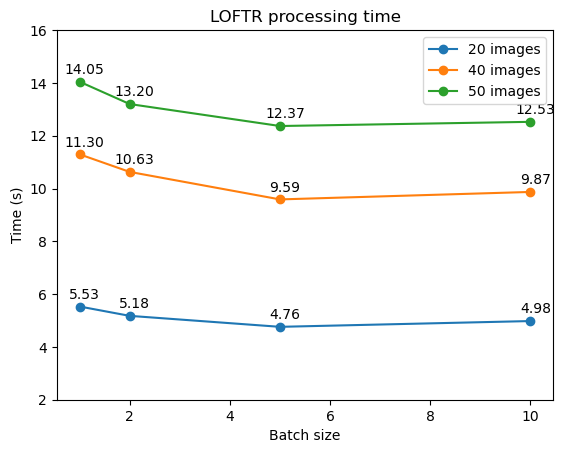

In [29]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
for i in proc_im.keys():
    if i==10:
        continue
    ax.plot(proc_im[i].keys(),proc_im[i].values(),'-o',label=f'{i} images')
    for x,y,z in zip(proc_im[i].keys(),proc_im[i].values(),proc_im[i].values()):
    #change f'{z:.2f}' to str(z) if you want something simpler
        ax.text(x+0.1,y+.3,f'{z:.2f}',horizontalalignment='center',color='k',weight='light')
ax.legend()
ax.set_xlabel('Batch size')
ax.set_ylabel('Time (s)')
ax.set_title('LOFTR processing time')
ax.set_ylim(2,16)

Text(0.5, 1.0, 'LOFTR processing time (10 images)')

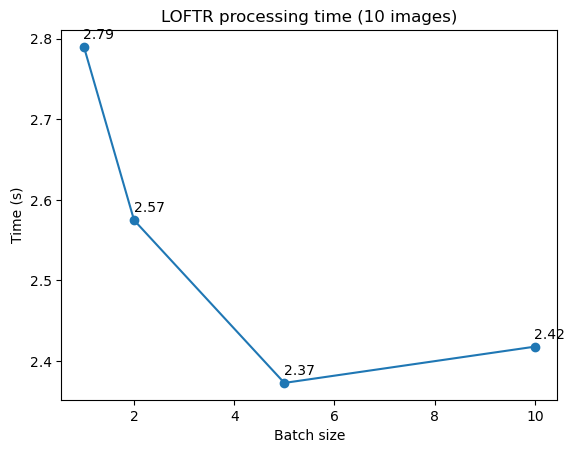

In [37]:
fig, ax = plt.subplots()
i=10
ax.plot(proc_im[i].keys(),proc_im[i].values(),'-o',label=f'{i} images')
for x,y,z in zip(proc_im[i].keys(),proc_im[i].values(),proc_im[i].values()):
#change f'{z:.2f}' to str(z) if you want something simpler
    ax.text(x+0.3,y+0.01,f'{z:.2f}',horizontalalignment='center',color='k',weight='light')

ax.set_xlabel('Batch size')
ax.set_ylabel('Time (s)')
ax.set_title('LOFTR processing time (10 images)')


(11.0, 15.0)

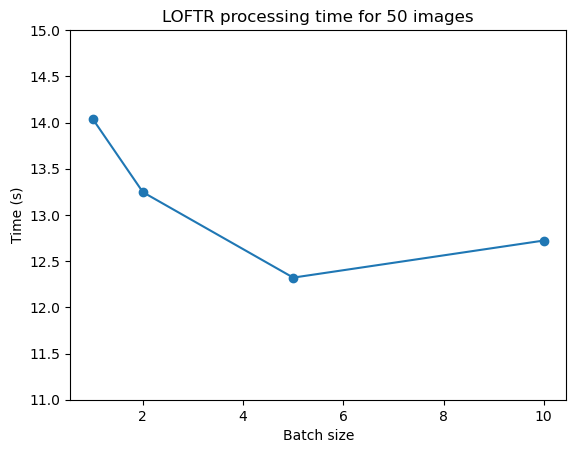

In [20]:
plt.plot(proc_im[50].keys(),proc_im[50].values(),'-o',label='50 images')
plt.xlabel('Batch size')
plt.ylabel('Time (s)')
plt.title('LOFTR processing time for 50 images')
plt.ylim(11,15)

# Mapping difference

Plotting x,y vs time for different thresholds, initial values:
- refresh_gaze=100
- optic flow=20
- gaze jump=50

## 146 sec recording

In [351]:
%matplotlib ipympl
plt.ion()

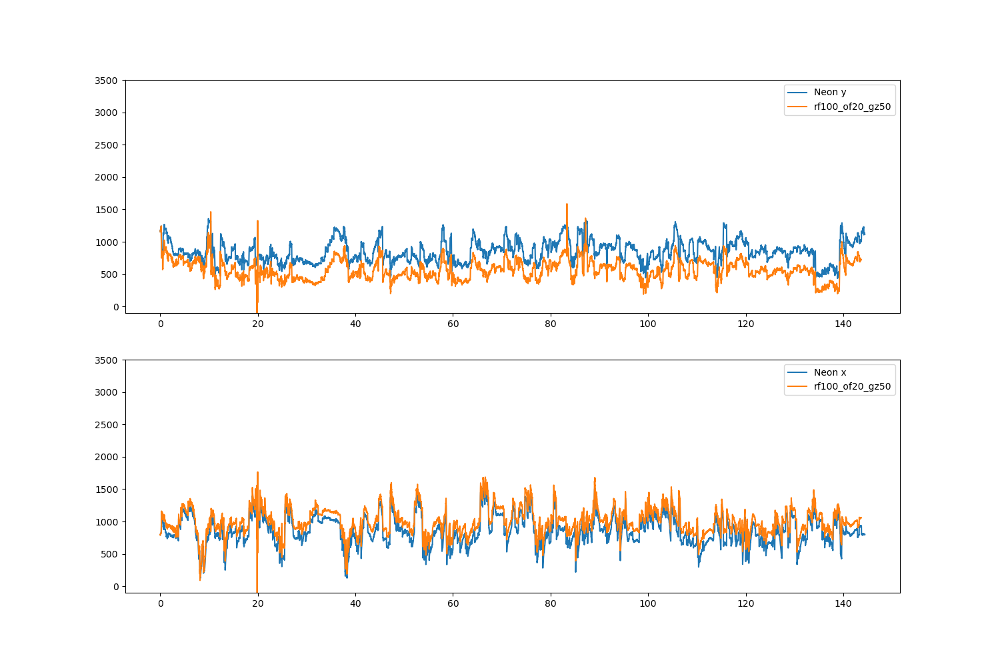

In [417]:
neon_gaze= pd.read_csv('/users/sof/gaze_mapping/raw_videos/Neon/Raw_Data/2024-02-16_wearingNeon/2024-02-16_15-58-13-6310bec3/gaze.csv')
t_neon=neon_gaze['timestamp [ns]'].values.astype(np.float64)
t_neon-=t_neon[0]
t_neon/=1e9


action_gaze= pd.read_csv('/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv')
t=action_gaze['timestamp [ns]'].values.astype(np.float64)
t-=neon_gaze['timestamp [ns]'].values[0]
t/=1e9


plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
plt.plot(t_neon,neon_gaze['gaze y [px]'].values,label='Neon y')
plt.plot(t,action_gaze['gaze y [px]'].values,label='rf100_of20_gz50')
plt.ylim(-100,3500)

plt.legend()
plt.subplot(2,1,2)
plt.plot(t_neon,neon_gaze['gaze x [px]'].values,label='Neon x')
plt.plot(t,action_gaze['gaze x [px]'].values,label='rf100_of20_gz50')
plt.ylim(-100,3500)
plt.legend()
plt.show()




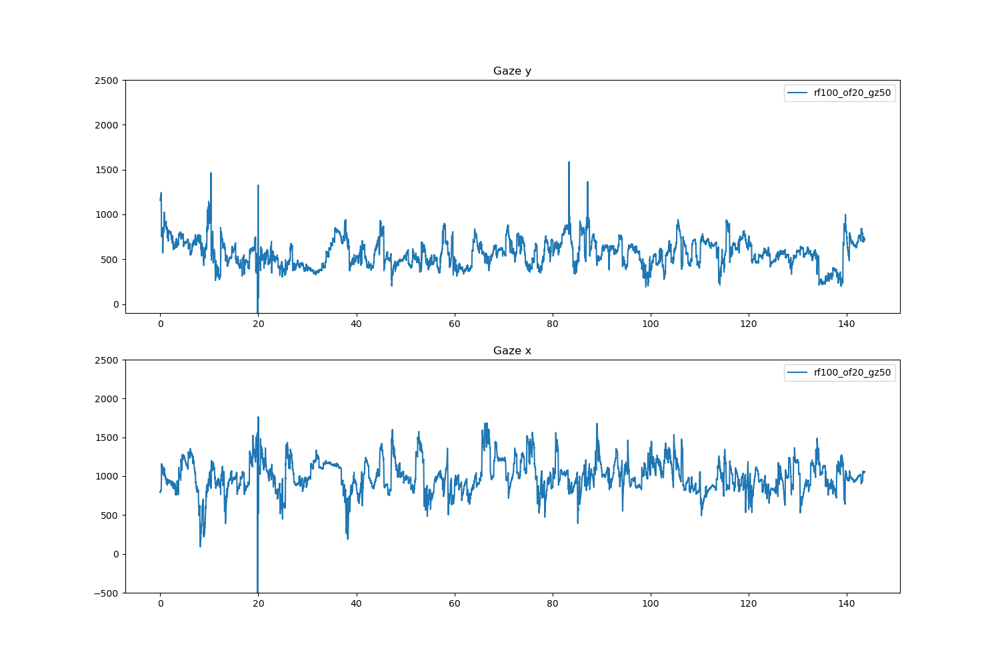

In [411]:
action_gaze= pd.read_csv('/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/mapped_gaze/loftr/action_gaze_lk.csv')
t=action_gaze['timestamp [ns]'].values.astype(np.float64)
t-=neon_gaze['timestamp [ns]'].values[0]
t/=1e9
plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
plt.plot(t,action_gaze['gaze y [px]'].values,label='rf100_of20_gz50')
plt.ylim(-100,2500)
plt.title('Gaze y')
plt.legend()
plt.subplot(2,1,2)
plt.plot(t,action_gaze['gaze x [px]'].values,label='rf100_of20_gz50')
plt.ylim(-500,2500)
plt.legend()
plt.title('Gaze x')
plt.show()

### Optic flow threshold

In [418]:
matcher_call_df = pd.DataFrame(columns=['Refresh thrsld','OF threshold','Gaze jump thrsld','Number of matcher calls', 'Time'])

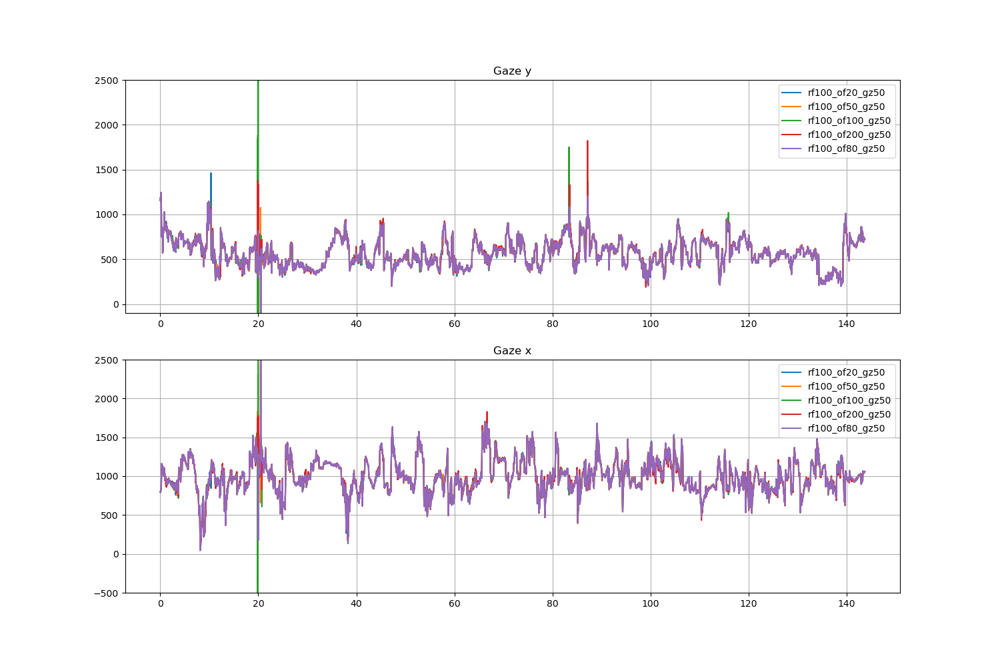

In [419]:
of_directory='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/OF'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_OF_loftr/'
fig,axs=plt.subplots(2,1,figsize=(15,10))
axs[0].plot(t,action_gaze['gaze y [px]'].values,label='rf100_of20_gz50')
axs[1].plot(t,action_gaze['gaze x [px]'].values,label='rf100_of20_gz50')
axs[0].grid()
axs[1].grid()
off=0
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9
    details=str(log_f.stem).split('_')[1:]
    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(details))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(details))

    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1
            
    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[1][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])
    
    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n, (end-start)/60]

axs[0].set_ylim(-100,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

### Gaze jump threshold

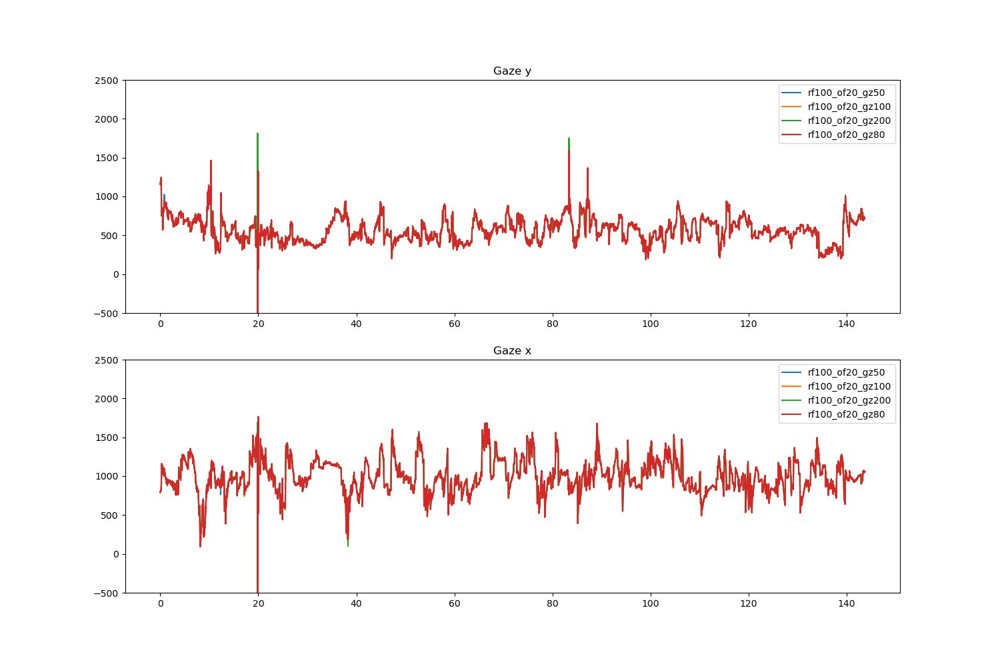

In [420]:
of_directory='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/gaze_jump'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_jump_loftr/'

fig,axs=plt.subplots(2,1,figsize=(15,10))
off=0
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    details=str(log_f.stem).split('_')[1:]
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9
    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    
    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1

    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[2][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])

    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n,(end-start)/60]
axs[0].set_ylim(-500,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

### Refresh rate threshold

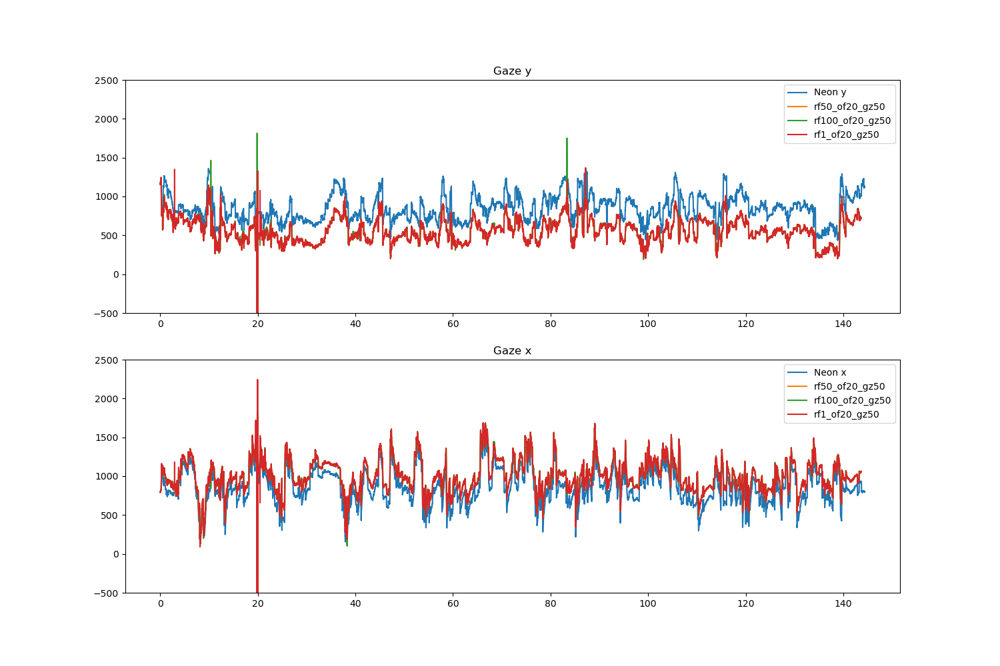

In [422]:
of_directory='/users/sof/action_map_experiments/new_mapper/wearingNeon_2m_rules_log/ref'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_ref_loftr/'

fig,axs=plt.subplots(2,1,figsize=(15,10))
off=0
axs[0].plot(t_neon,neon_gaze['gaze y [px]'].values,label='Neon y')
axs[1].plot(t_neon,neon_gaze['gaze x [px]'].values,label='Neon x')
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9
    details=str(log_f.stem).split('_')[1:]
    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    
    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1
    # off+=500
    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[0][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])
    
    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n,(end-start)/60]
axs[0].set_ylim(-500,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

In [423]:
matcher_call_df.drop_duplicates().sort_values(by='Number of matcher calls')

,Refresh thrsld,OF threshold,Gaze jump thrsld,Number of matcher calls,Time
2,rf100,of200,gz50,669,23.385785
1,rf100,of100,gz50,892,27.973865
3,rf100,of80,gz50,1011,23.476999
0,rf100,of50,gz50,1393,28.521671
6,rf100,of20,gz200,2942,33.345556
5,rf100,of20,gz100,2963,35.616015
7,rf100,of20,gz80,2983,28.674699
4,rf100,of20,gz50,3213,16.185962
9,rf100,of20,gz50,3213,32.157556
8,rf50,of20,gz50,3249,15.988457


## 43 sec recording

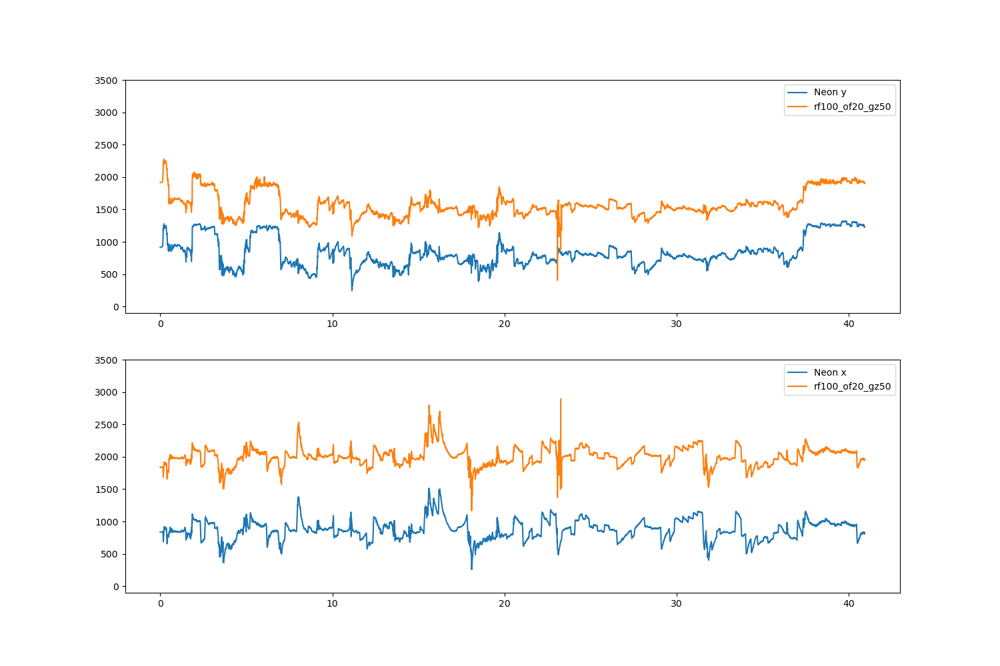

In [425]:
neon_gaze= pd.read_csv('/users/sof/video_examples/second_video/2024-05-23_16-47-35-a666ea62/gaze.csv')
t_neon=neon_gaze['timestamp [ns]'].values.astype(np.float64)
t_neon-=t_neon[0]
t_neon/=1e9
action_gaze= pd.read_csv('/users/sof/action_map_experiments/new_mapper/second_video_rules_log/mapped_gaze/loftr/action_gaze_lk.csv')
t=action_gaze['timestamp [ns]'].values.astype(np.float64)
t-=neon_gaze['timestamp [ns]'].values[0]
t/=1e9

plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
plt.plot(t_neon,neon_gaze['gaze y [px]'].values,label='Neon y')
plt.plot(t,action_gaze['gaze y [px]'].values+1000,label='rf100_of20_gz50')

plt.ylim(-100,3500)

plt.legend()
plt.subplot(2,1,2)
plt.plot(t_neon,neon_gaze['gaze x [px]'].values,label='Neon x')
plt.plot(t,action_gaze['gaze x [px]'].values+1000,label='rf100_of20_gz50')
plt.ylim(-100,3500)
plt.legend()
plt.show()

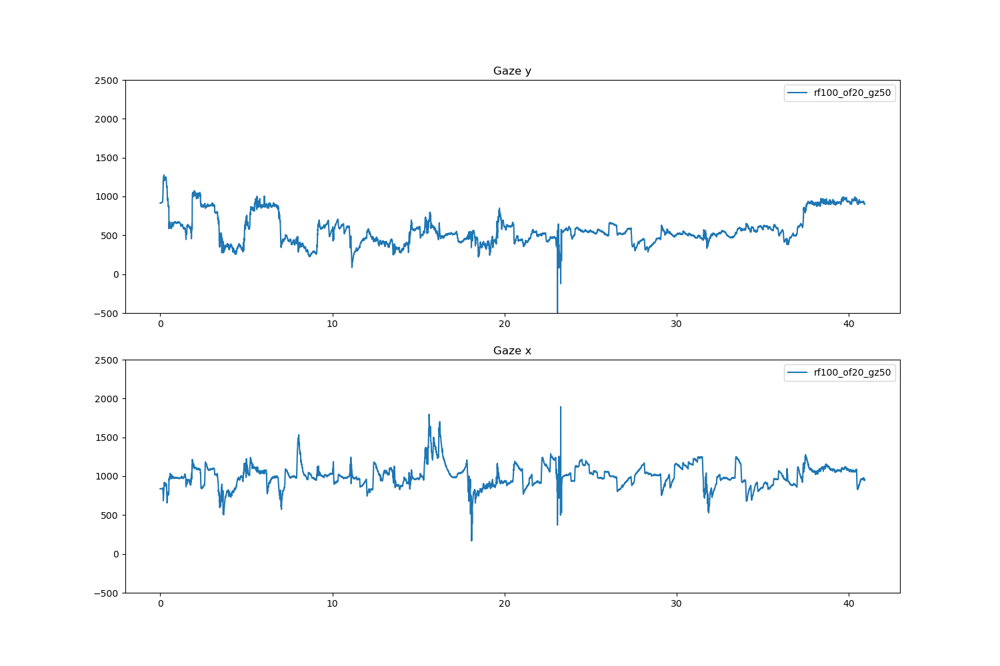

In [426]:
action_gaze= pd.read_csv('/users/sof/action_map_experiments/new_mapper/second_video_rules_log/mapped_gaze/loftr/action_gaze_lk.csv')
t=action_gaze['timestamp [ns]'].values.astype(np.float64)
t-=neon_gaze['timestamp [ns]'].values[0]
t/=1e9
plt.figure(figsize=(15,10))
plt.subplot(2,1,1)
plt.plot(t,action_gaze['gaze y [px]'].values,label='rf100_of20_gz50')
plt.ylim(-500,2500)
plt.title('Gaze y')
plt.legend()
plt.subplot(2,1,2)
plt.plot(t,action_gaze['gaze x [px]'].values,label='rf100_of20_gz50')
plt.ylim(-500,2500)
plt.legend()
plt.title('Gaze x')
plt.show()

### Optic flow threshold

In [427]:
matcher_call_df = pd.DataFrame(columns=['Refresh thrsld','OF threshold','Gaze jump thrsld','Number of matcher calls','Time (min)'])

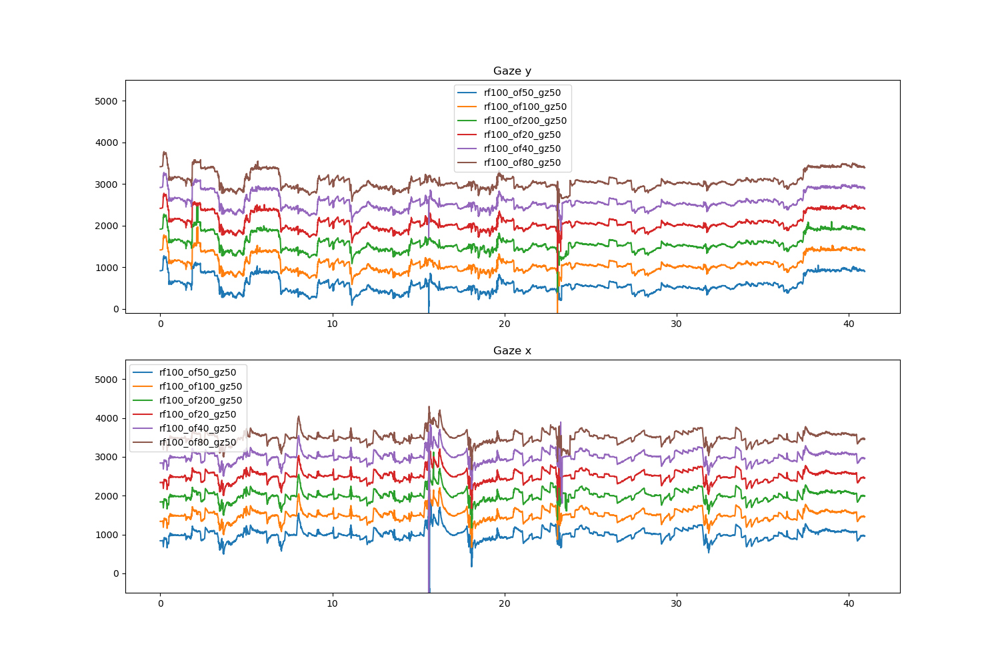

In [428]:
of_directory='/users/sof/action_map_experiments/new_mapper/second_video_rules_log/OF'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_OF_loftr/'

fig,axs=plt.subplots(2,1,figsize=(15,10))
off=0
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    details=str(log_f.stem).split('_')[1:]
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9

    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    
    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1
    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[1][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])
    off+=500
    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n,(end-start)/60]

axs[0].set_ylim(-100,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

### Gaze jump threshold

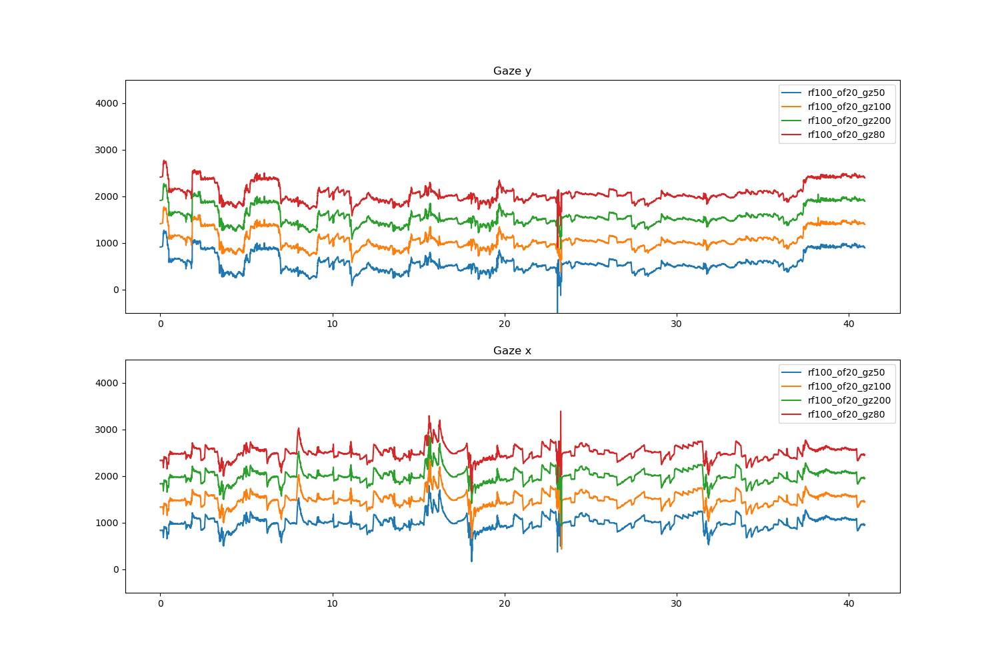

In [429]:
of_directory='/users/sof/action_map_experiments/new_mapper/second_video_rules_log/gaze_jump'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_jump_loftr/'
fig,axs=plt.subplots(2,1,figsize=(15,10))
off=0
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    details=str(log_f.stem).split('_')[1:]
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9
    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1
    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[2][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])
    off+=500
    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n,(end-start)/60]
axs[0].set_ylim(-500,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

### Refresh rate threshold

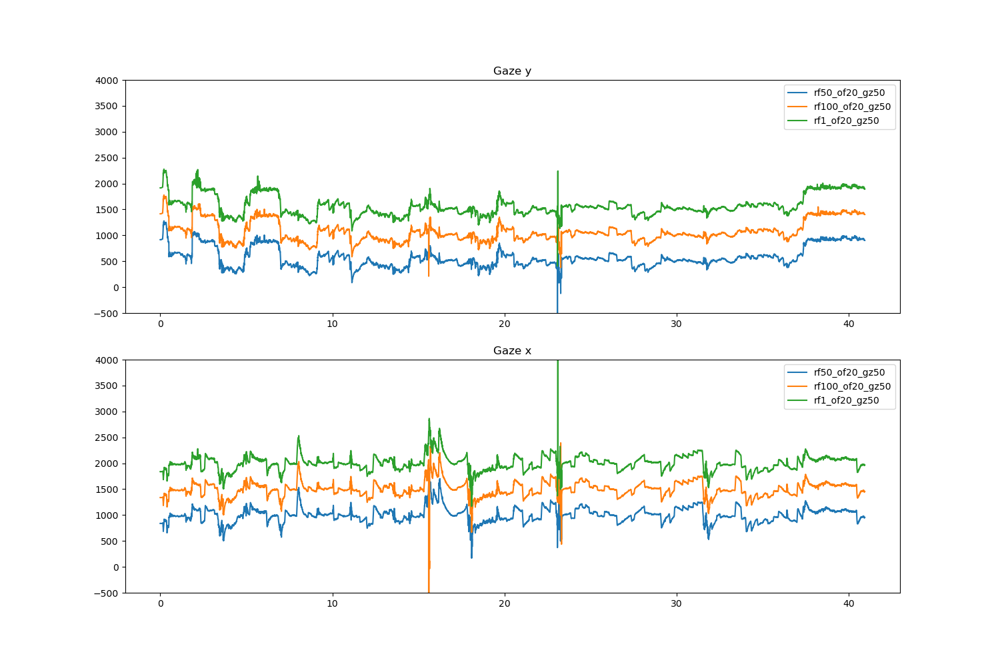

In [430]:
of_directory='/users/sof/action_map_experiments/new_mapper/second_video_rules_log/ref'
cluster_dir='/users/sof/cluster_runs/action_cam_mapper/changing_ref_loftr/'

fig,axs=plt.subplots(2,1,figsize=(15,10))
off=0
for csv_f,log_f in zip(Path(of_directory).rglob('*.csv'),Path(of_directory).rglob('*.log')):
    details=str(log_f.stem).split('_')[1:]
    action_gaze= pd.read_csv(csv_f)
    t=action_gaze['timestamp [ns]'].values.astype(np.float64)
    t-=neon_gaze['timestamp [ns]'].values[0]
    t/=1e9
    axs[0].plot(t,action_gaze['gaze y [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    axs[1].plot(t,action_gaze['gaze x [px]'].values+off,label='_'.join(str(log_f.stem).split('_')[1:]))
    with open(log_f,'r') as f:
        lines = f.readlines()
        n=0
    for line in lines:
        if '_map_one_gaze' and 'Matcher' in line:
            n+=1
    cluster_file= cluster_dir+f'{str(Path(of_directory).parent.stem)}_{details[0][2:]}/'
    job_f = [job_f  for job_f in Path(cluster_file).rglob('job-*.txt')]
    job_f.sort()
    with open(job_f[0],'r') as f:
        end =float(f.readlines()[1])
    with open(job_f[1],'r') as f:
        start =float(f.readlines()[1])
    off+=500
    matcher_call_df.loc[len(matcher_call_df)]=[*str(log_f.stem).split('_')[1:],n,(end-start)/60]
axs[0].set_ylim(-500,2500+off)
axs[0].set_title('Gaze y')
axs[0].legend()
axs[1].set_ylim(-500,2500+off)
axs[1].set_title('Gaze x')
axs[1].legend()
plt.show()

In [431]:
matcher_call_df.drop_duplicates().sort_values(by='Number of matcher calls')

,Refresh thrsld,OF threshold,Gaze jump thrsld,Number of matcher calls,Time (min)
2,rf100,of200,gz50,376,8.376703
1,rf100,of100,gz50,434,3.972835
5,rf100,of80,gz50,463,8.383766
0,rf100,of50,gz50,570,9.238790
4,rf100,of40,gz50,647,9.026745
8,rf100,of20,gz200,834,10.603825
7,rf100,of20,gz100,873,10.848172
9,rf100,of20,gz80,909,9.271618
3,rf100,of20,gz50,1064,9.334355
6,rf100,of20,gz50,1064,9.425252
